In [1]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import matplotlib.patches as patches
import matplotlib.gridspec as gridspec
import time
from tensorflow.python.layers.base import Layer

/opt/conda/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: compiletime version 3.5 of module 'tensorflow.python.framework.fast_tensor_util' does not match runtime version 3.6
  return f(*args, **kwds)
/opt/conda/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [2]:
def make_toy_dataset_old(num_samples,noise):
    cir_sample=num_samples*2//3
    circle_circ_x = np.cos(np.linspace(0, np.pi, cir_sample))
    circle_circ_y = np.sin(np.linspace(0, np.pi, cir_sample))
    norm_sample=num_samples-cir_sample
    norm_circ_x = np.zeros(norm_sample)
    norm_circ_y = np.zeros(norm_sample)
    X=np.vstack((np.append(circle_circ_x,norm_circ_x),np.append(circle_circ_y,norm_circ_y))).T
    X += np.random.randn(X.shape[0],X.shape[1])*noise
    index=np.arange(num_samples)
    np.random.shuffle(index)
    return X[index,:]

def make_toy_dataset(num_samples,noise):
    circle_circ_x = np.cos(np.linspace(0, np.pi, num_samples))
    circle_circ_y = np.sin(np.linspace(0, np.pi, num_samples))
    X=np.vstack((circle_circ_x,circle_circ_y)).T
    X += np.random.randn(X.shape[0],X.shape[1])*noise
    index=np.arange(num_samples)
    np.random.shuffle(index)
    return X[index,:]

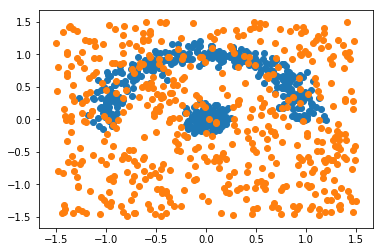

In [3]:
X_true=make_toy_dataset_old(500,0.1)
X_fake=np.random.uniform(low=-1.5,high=1.5,size=(500,2))
plt.scatter(X_true[:,0],X_true[:,1])
plt.scatter(X_fake[:,0],X_fake[:,1])
plt.show()

In [4]:
'''
**************************************************************************************************************
Problem: this model try to predict everything sample as positive to minimize loss
potential solution: saparate into two step: first freeze VAE, optimize classifier. Then optimize VAE
plan B: train a global classifier to classify true sample and uniform random noise(cover all true sample),
then freeze classifier, increase score of VAE output
**************************************************************************************************************
'''

tf.reset_default_graph()
X=tf.placeholder(dtype=tf.float32,shape=[None,2])
y=tf.placeholder(dtype=tf.int32,shape=[None])

mask_psed_neg=tf.reshape(tf.cast(tf.equal(y,1),tf.float32),(-1,1))
mask_not_psed_neg=tf.reshape(tf.cast(tf.logical_not(tf.equal(y,1)),tf.float32),(-1,1))

y_onehot=tf.one_hot(y,3)
eps=1e-10

class Classifier(Layer):
    def __init__(self):
        self.linear1=tf.layers.Dense(units=256,name='linear1',activation=tf.nn.relu,_reuse=tf.AUTO_REUSE)
        self.linear2=tf.layers.Dense(units=256,name='linear2',activation=tf.nn.relu,_reuse=tf.AUTO_REUSE)
        self.linear3=tf.layers.Dense(units=256,name='linear3',activation=tf.nn.relu,_reuse=tf.AUTO_REUSE)
        self.linear4=tf.layers.Dense(units=3,name='linear4',_reuse=tf.AUTO_REUSE)
    
    def __call__(self,inputs):
        score=self.linear4(self.linear3(self.linear2(self.linear1(inputs))))
        return score
    
class VAE(Layer):
    def __init__(self):
        self.lstm_hidden_dim=20
        self.latent_dim=10
        self.n_time=4
        self.encoder_lstm=tf.contrib.rnn.LSTMCell(self.lstm_hidden_dim)
        self.decoder_lstm=tf.contrib.rnn.LSTMCell(self.lstm_hidden_dim)
        self.encode_mean=tf.layers.Dense(units=self.latent_dim,name='encode_mean')   # calculate mean of z
        self.encode_std=tf.layers.Dense(units=self.latent_dim,name='encode_std')   # calculate std of z
        self.unit_gaussian=tf.distributions.Normal(loc=tf.zeros(self.latent_dim),scale=tf.ones(self.latent_dim))
        self.emit_net=tf.layers.Dense(units=2,name='emit_net')
        
    def __call__(self,inputs):
        batch_size=tf.shape(inputs)[0]
        state_encode=self.encoder_lstm.zero_state(batch_size, tf.float32)   # lstm tuple (c,h)
        state_decode=self.decoder_lstm.zero_state(batch_size, tf.float32)   # lstm tuple (c,h)
        original_image=tf.layers.flatten(inputs)
        output_image=None
        latent_loss_his=[]
        classifier_loss_his=[]
        likelihood_his=[]
        predict_his=[]
        image_his=[]
        
        for t in range(self.n_time):
            if t==0:
                image=original_image
            else:
                # use output_image for fake images, use original image for real image
                image=mask_psed_neg*output_image+mask_not_psed_neg*original_image
            image_his.append(image)
            '''
            Part I: Classifier
            **************************************************************************************************************
            There is a problem with classifier. 
            During classifing, we only want to train the variables in the classifiers.  (solved)
            During likelihood estimation, we do not want to change the variables in the classifiers. (unsolved)
            **************************************************************************************************************
            '''
            classifier_scope="CNN_classifier_"+str(t)
            input_image=tf.reshape(image,(-1,2))
            with tf.variable_scope(classifier_scope) as vs:
                classifier=Classifier()
                score_likelihood=classifier(input_image)
            with tf.variable_scope(classifier_scope) as vs:
                classifier=Classifier()
                score_classifier=classifier(tf.stop_gradient(input_image))
            
            score_likelihood=tf.reshape(score_likelihood[:,0]-score_likelihood[:,1],(-1,1))*mask_psed_neg
            likelihood_his.append(score_likelihood) # only record score for fake images
            classifier_loss_his.append(tf.losses.softmax_cross_entropy(logits=score_classifier,onehot_labels=y_onehot))
            predict_his.append(score_classifier)
            
            '''
            Part II: Recurrent VAE
            '''
            with tf.variable_scope("LSTM_encoder") as vs:
                encode_out,state_encode=self.encoder_lstm(image,state_encode)
            z_mean=self.encode_mean(encode_out)
            z_std=tf.exp(self.encode_std(encode_out))
            distrib_encode=tf.distributions.Normal(loc=z_mean,scale=z_std)
            Z=distrib_encode.sample()
            
            latent_loss=tf.reduce_sum(mask_psed_neg*tf.distributions.kl_divergence(distrib_encode,self.unit_gaussian),axis=1)
            latent_loss_his.append(latent_loss)
            
            with tf.variable_scope("LSTM_decoder") as vs:
                decode_out,state_decode=self.decoder_lstm(Z,state_decode)
                
            output_image=self.emit_net(decode_out)
            
        tot_latent_loss=tf.reduce_mean(latent_loss_his)
        tot_classifier_loss=tf.reduce_mean(classifier_loss_his)
        tot_likelihood_loss=tf.reduce_sum(likelihood_his,axis=0)  # accumulate score through time
#         tot_likelihood_loss=tf.reduce_mean(-tf.nn.sigmoid(tot_likelihood_loss))
        tot_likelihood_loss=tf.reduce_mean(-tot_likelihood_loss)
        
        tot_loss=tot_latent_loss+tot_classifier_loss+tot_likelihood_loss
            
        return image_his,tot_loss,tot_latent_loss,tot_classifier_loss,tot_likelihood_loss,predict_his


vae=VAE()
image_his,tot_loss,tot_latent_loss,tot_classifier_loss,tot_likelihood_loss,predict_his=vae(X)
tot_classifier_loss=tot_classifier_loss
tot_loss2=tot_latent_loss+tot_likelihood_loss

optimizier=tf.train.AdamOptimizer(learning_rate=1e-2)
train_step1 = optimizier.minimize(tot_classifier_loss)
train_step2 = optimizier.minimize(tot_loss2)

In [5]:
vv0=[v for v in tf.global_variables() if v.name=='CNN_classifier_0/linear1/kernel:0'][0]
vv1=[v for v in tf.global_variables() if v.name=='CNN_classifier_1/linear1/kernel:0'][0]
vv2=[v for v in tf.global_variables() if v.name=='CNN_classifier_2/linear1/kernel:0'][0]
vv3=[v for v in tf.global_variables() if v.name=='CNN_classifier_3/linear1/kernel:0'][0]

new_score=[]

for t in range(4):
    with tf.variable_scope("CNN_classifier_"+str(t)) as vs:
        classifier=Classifier()
        n_score=classifier(X)
        new_score.append(n_score)

In [6]:
with tf.Session() as sess:
    tf.global_variables_initializer().run()
    X_true=make_toy_dataset_old(200,0.1)
    X_fake=np.random.uniform(low=-1.5,high=1.5,size=(200,2))
    X_noise=np.random.uniform(low=-1.5,high=1.5,size=(200,2))
    image=np.vstack((X_true,X_fake,X_noise))
    label=np.concatenate((np.zeros(200),np.ones(200),2*np.ones(200)))
    a=sess.run(predict_his,feed_dict={X:image,y:label})
    b=sess.run(new_score,feed_dict={X:image,y:label})

In [7]:
# for v in tf.global_variables():
#     print(v)

In [8]:
# vv=[v for v in tf.global_variables() if v.name=='CNN_classifier_0/linear1/kernel:0'][0]
# vv2=[v for v in tf.global_variables() if v.name=='CNN_classifier_1/linear1/kernel:0'][0]
# vv3=[v for v in tf.global_variables() if v.name=='encode_mean/kernel:0'][0]
# a=tf.gradients(tot_loss,vv)[0]
# b=tf.gradients(tot_latent_loss,vv)[0]
# c=tf.gradients(tot_classifier_loss,vv)[0]
# d=tf.gradients(tot_likelihood_loss,vv)[0]
# print(a)
# print(b)
# print(c)
# print(d)

# with tf.Session() as sess:
#     tf.global_variables_initializer().run()
#     original0=sess.run(vv)
#     original1=sess.run(vv2)
#     X_true=make_toy_dataset(200,0.1)
#     X_fake=np.random.uniform(low=-1.5,high=1.5,size=(200,2))
#     image=np.vstack((X_true,X_fake))
#     label=np.concatenate((np.ones(200),np.zeros(200)))
#     ga=sess.run(a,feed_dict={X:image,y:label})
#     gc=sess.run(c,feed_dict={X:image,y:label})
#     gd=sess.run(d,feed_dict={X:image,y:label})
#     _=sess.run(train_step,feed_dict={X:image,y:label})
#     latter0=sess.run(vv)
#     latter1=sess.run(vv2)
# #     print(original0-latter0)
# #     print(original1-latter1)

In [9]:
# out1=tf.layers.dense(X,units=20,activation=tf.nn.relu)
# score=tf.layers.dense(out1,units=1)
# prob=tf.nn.sigmoid(score)
# predict=tf.cast(prob>0.5,tf.int32)

# with tf.Session() as sess:
#     tf.global_variables_initializer().run()
#     X_true=make_toy_dataset(200,0.1)
#     X_fake=np.random.uniform(low=-1.5,high=1.5,size=(200,2))
#     image=np.vstack((X_true,X_fake))
#     label=np.concatenate((np.ones(200),np.zeros(200)))
#     p=sess.run(predict,feed_dict={X:image,y:label})
#     print(p.reshape(-1,))
    

In [10]:
def display(i_his,image_id): 
    plt.figure(1)
    h=0.1
    xx, yy = np.meshgrid(
        np.arange(-1.5, 1.5, h),
        np.arange(-1.5, 1.5, h))
    points=np.c_[xx.ravel(), yy.ravel()]
    p_his=sess.run(new_score,feed_dict={X:points,y:np.zeros(points.shape[0])})
    for t in range(4):
        plt.subplot(2,2,t+1)
        Z=np.argmax(p_his[t],axis=1)
        Z=Z.reshape(xx.shape)
#         print('t =',t,Z)
        _=plt.contourf(xx,yy,Z,cmap=plt.cm.coolwarm_r, alpha=0.8)
        plt.scatter(i_his[t][:200,0],i_his[t][:200,1])
        plt.scatter(i_his[t][200:400,0],i_his[t][200:400,1])
#         plt.scatter(i_his[t][400:,0],i_his[t][400:,1])
        plt.axis('off')
        plt.colorbar(_)
    if image_id==0 or (image_id+1)%50==0:
        plt.savefig('figures/toy_dataset_%03d.png' % (image_id+1))
    plt.show()

iteration  0
1.1260816 0.007268091 1.1009985 0.017814944


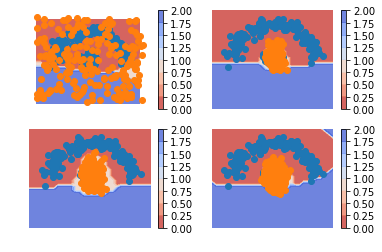

iteration  1
2.4145002 0.0067110127 0.783934 1.6238552


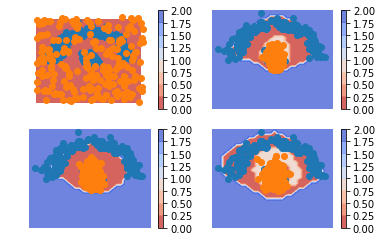

iteration  2
0.66850466 0.0060668206 0.80533886 -0.142901


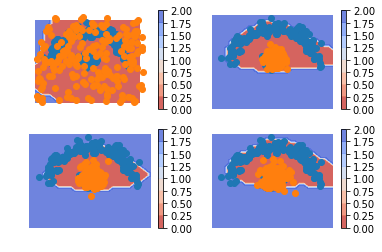

iteration  3
0.35311133 0.0055899285 0.77347255 -0.42595112


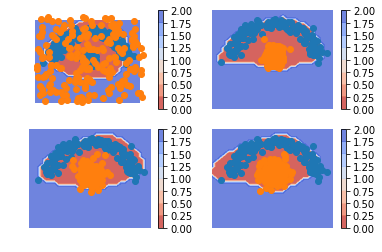

iteration  4
0.24172223 0.0053431946 0.7888332 -0.5524542


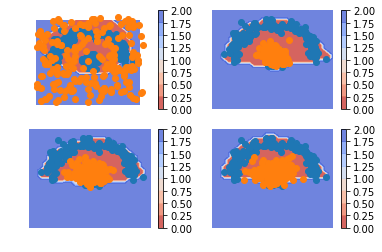

iteration  5
0.30396184 0.0056970357 0.7415671 -0.44330224


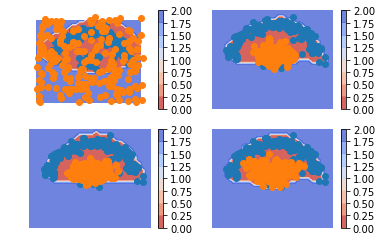

iteration  6
0.29270315 0.0059184064 0.7365864 -0.44980162


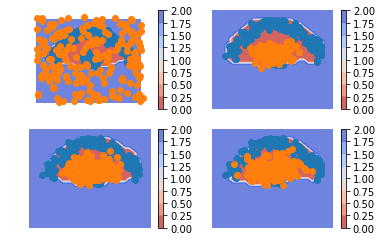

iteration  7
0.27021766 0.007811226 0.80846786 -0.54606146


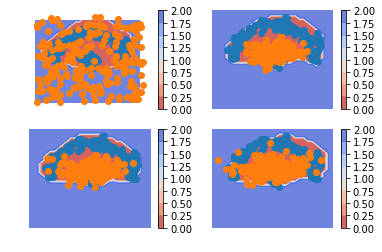

iteration  8
0.18423164 0.0106621375 0.8404223 -0.6668528


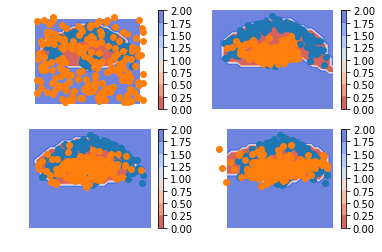

iteration  9
0.05264765 0.015243867 0.85302913 -0.81562537


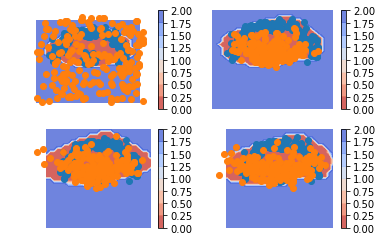

iteration  10
0.33856416 0.017703291 0.8766297 -0.55576885


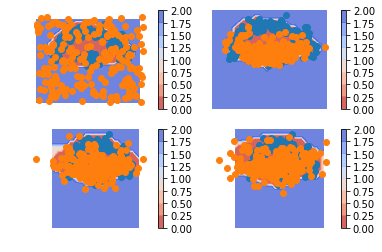

iteration  11
0.3522256 0.015599298 0.8499564 -0.5133301


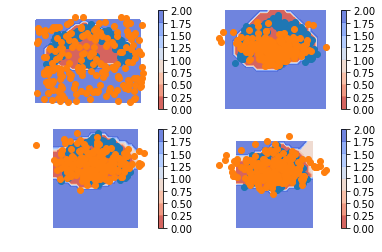

iteration  12
0.3300162 0.011340787 0.87795055 -0.55927515


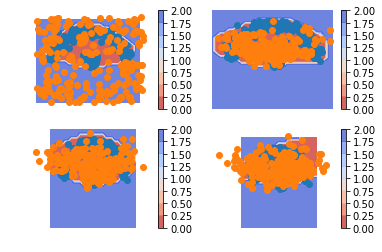

iteration  13
0.2487514 0.007971211 0.88240236 -0.6416222


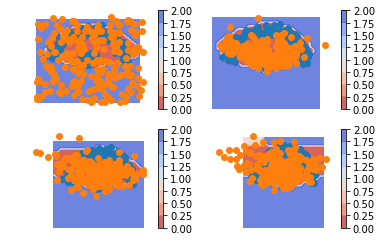

iteration  14
0.12855786 0.005819991 0.8696138 -0.74687594


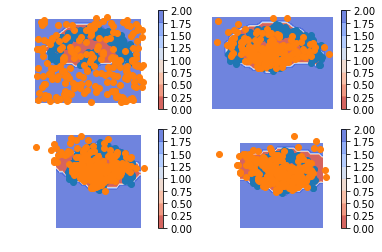

iteration  15
0.1662867 0.0053143734 0.86179066 -0.7008183


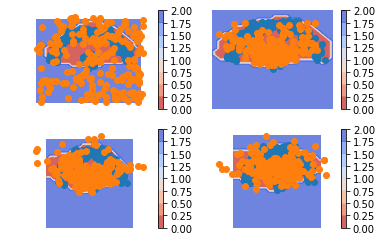

iteration  16
0.15836906 0.0058060074 0.838007 -0.68544394


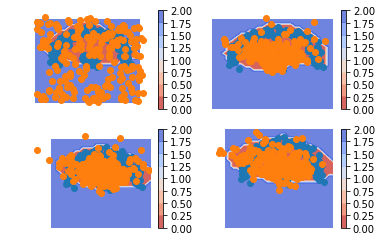

iteration  17
0.13235617 0.0070579457 0.8339298 -0.7086316


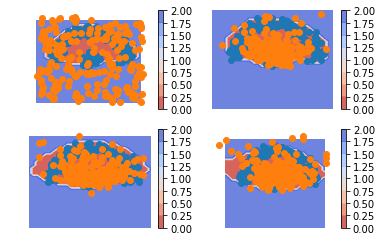

iteration  18
0.16304594 0.008498596 0.80744874 -0.6529014


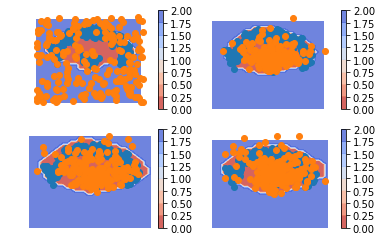

iteration  19
0.12670344 0.008655643 0.8049584 -0.6869106


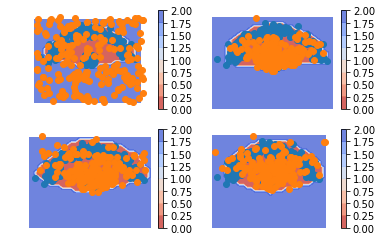

iteration  20
0.19120347 0.0088582 0.8355714 -0.65322614


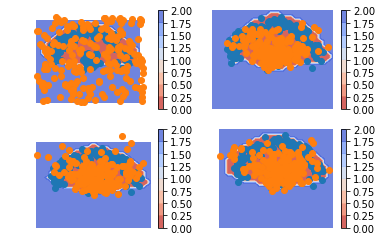

iteration  21
0.17968816 0.008313276 0.8510393 -0.67966443


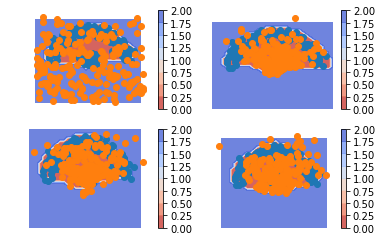

iteration  22
0.23248011 0.0065209502 0.8148204 -0.5888612


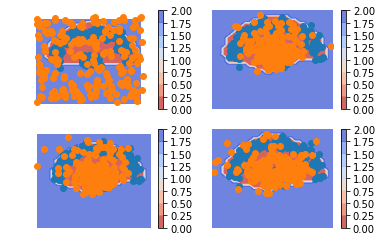

iteration  23
0.1874916 0.0055138883 0.8320477 -0.65007


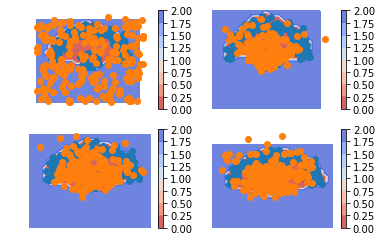

iteration  24
0.24704927 0.004824485 0.784462 -0.54223716


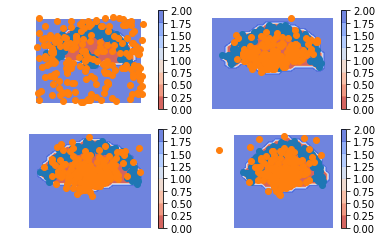

iteration  25
0.26644272 0.0052671432 0.85121775 -0.5900422


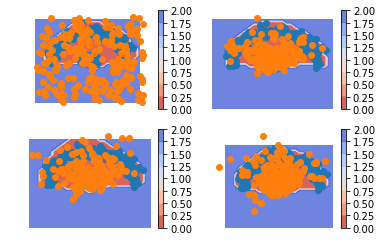

iteration  26
0.21883672 0.0059845573 0.8489355 -0.6360833


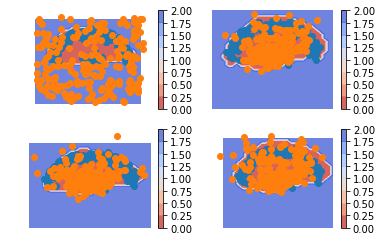

iteration  27
0.3077705 0.0053389017 0.8154814 -0.51304984


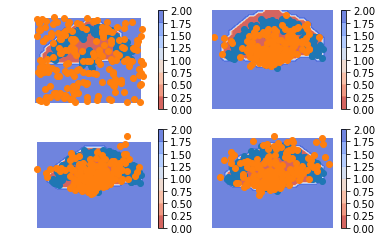

iteration  28
0.07609582 0.004779829 0.80378044 -0.73246443


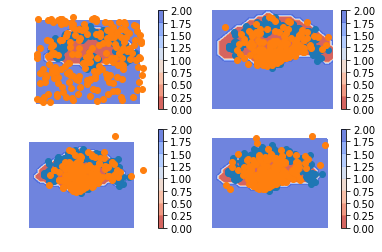

iteration  29
0.22699434 0.0049372897 0.82709837 -0.6050413


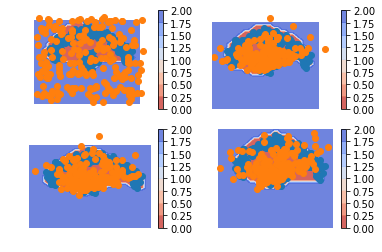

iteration  30
0.26514143 0.0052399035 0.822367 -0.5624655


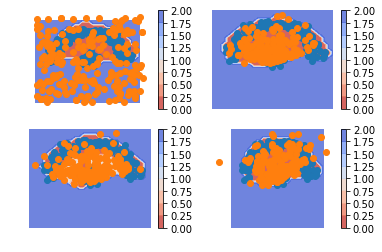

iteration  31
0.27322966 0.0059625944 0.7851679 -0.5179008


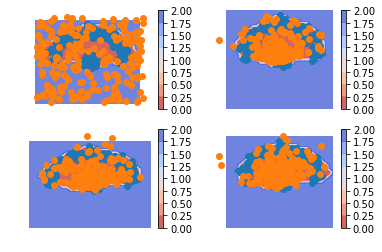

iteration  32
0.20147109 0.0072605815 0.80275047 -0.60853994


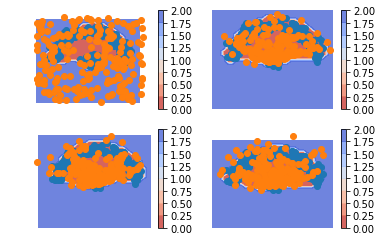

iteration  33
0.18813568 0.009576859 0.8235152 -0.64495635


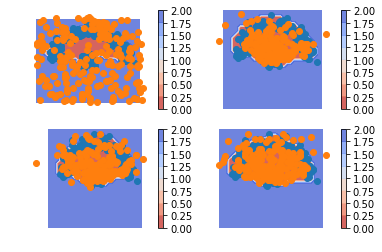

iteration  34
0.32799658 0.010198062 0.8121501 -0.4943516


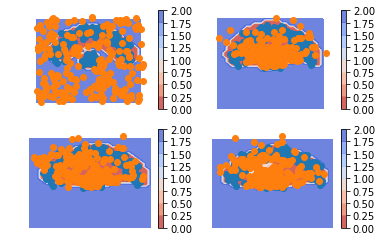

iteration  35
0.20871788 0.008704111 0.8393503 -0.6393365


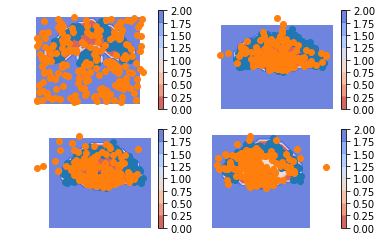

iteration  36
0.28543317 0.007171516 0.8206659 -0.54240423


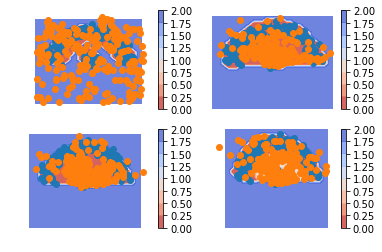

iteration  37
0.25242007 0.005920537 0.81885386 -0.5723543


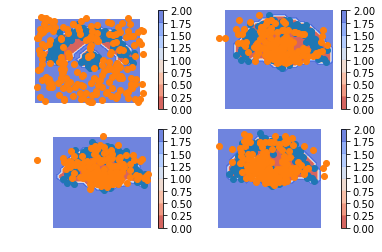

iteration  38
0.28675622 0.005231496 0.8047172 -0.52319247


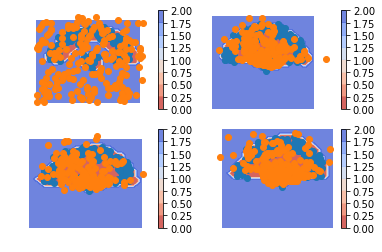

iteration  39
0.18414766 0.0049137785 0.79656947 -0.6173356


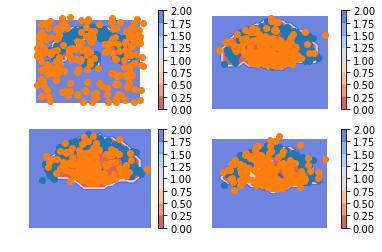

iteration  40
0.3156936 0.005014491 0.7938312 -0.48315212


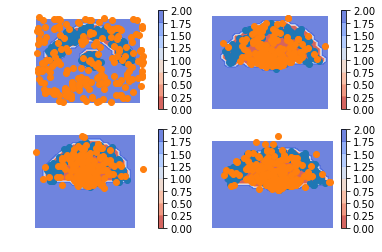

iteration  41
0.17960286 0.004905662 0.78913474 -0.6144375


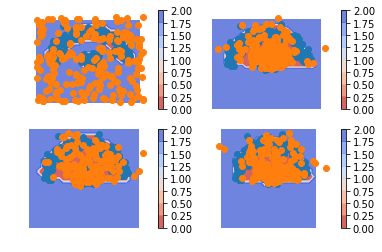

iteration  42
0.21734554 0.004900335 0.7969948 -0.5845496


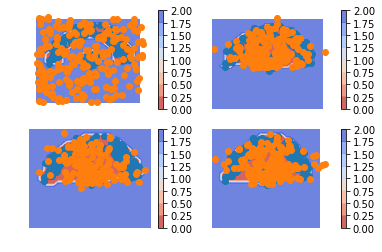

iteration  43
0.16453415 0.004988857 0.81247056 -0.65292525


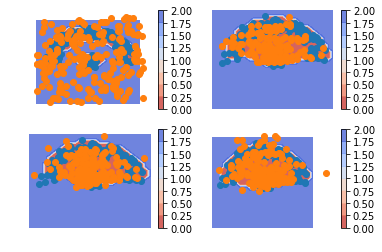

iteration  44
0.25920337 0.005347006 0.7929652 -0.5391088


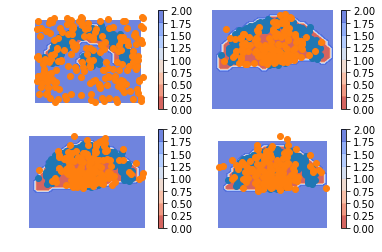

iteration  45
0.18724984 0.0055972454 0.7895508 -0.6078982


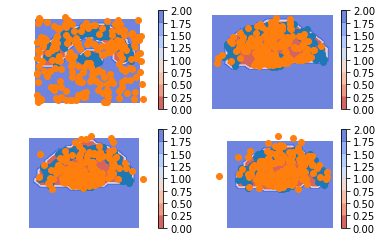

iteration  46
0.19597167 0.005795809 0.8020649 -0.61188906


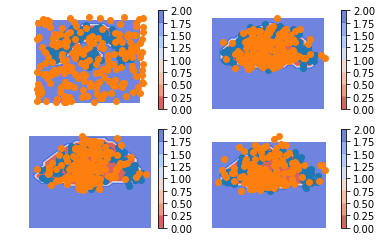

iteration  47
0.28118813 0.005684169 0.836051 -0.56054705


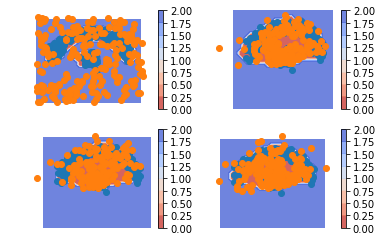

iteration  48
0.15718657 0.0058836327 0.8047621 -0.6534592


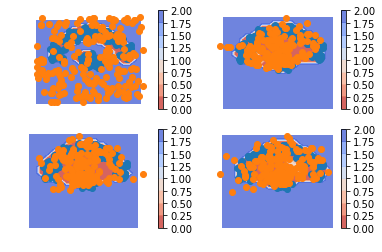

iteration  49
0.17498028 0.006085791 0.8065289 -0.63763446


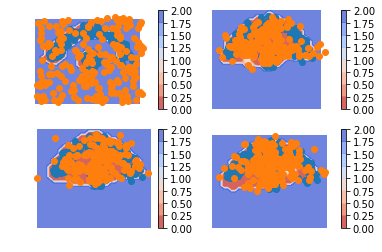

iteration  50
0.22669977 0.0059775584 0.77513963 -0.55441743


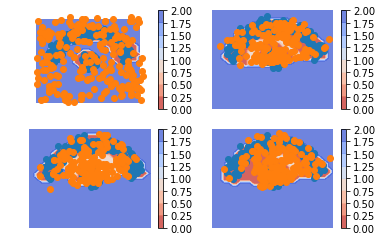

iteration  51
0.28002828 0.0065872255 0.80799234 -0.53455126


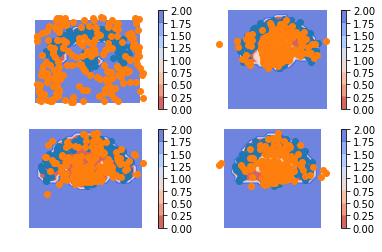

iteration  52
0.18099982 0.0067287832 0.77799106 -0.60372


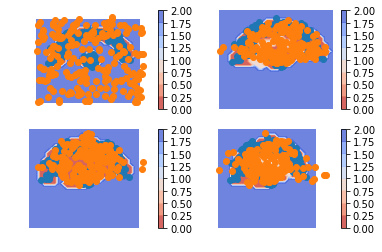

iteration  53
0.18419671 0.0074862232 0.80214006 -0.6254296


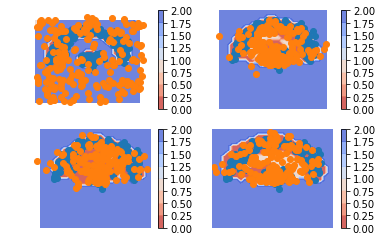

iteration  54
0.27425772 0.0077439533 0.8325331 -0.56601936


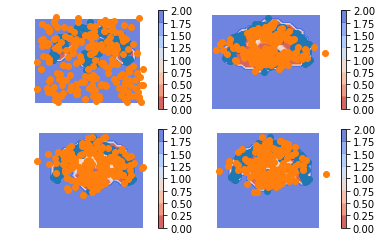

iteration  55
0.3020644 0.008578879 0.78812295 -0.49463746


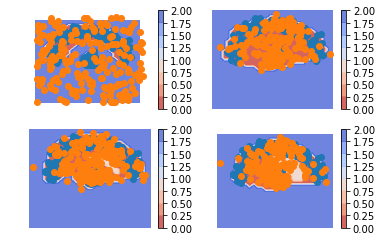

iteration  56
0.16967988 0.009049702 0.81415486 -0.6535247


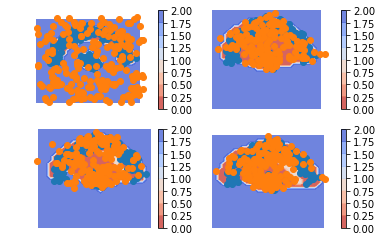

iteration  57
0.20880997 0.0088489195 0.80214405 -0.602183


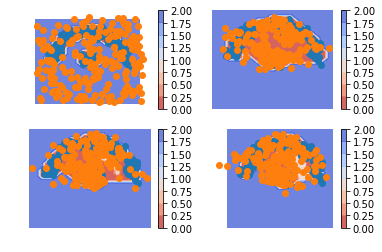

iteration  58
0.18157136 0.00769773 0.8256165 -0.6517428


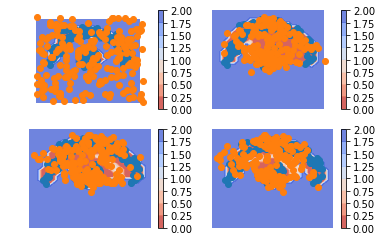

iteration  59
0.20711017 0.006583943 0.80785614 -0.6073299


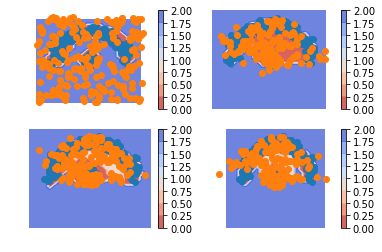

iteration  60
0.18943435 0.0056907027 0.813897 -0.63015336


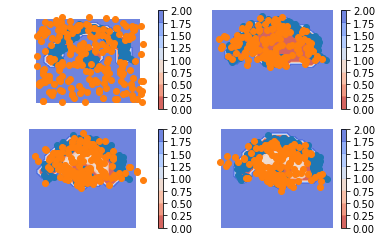

iteration  61
0.19569892 0.004579549 0.7901307 -0.5990113


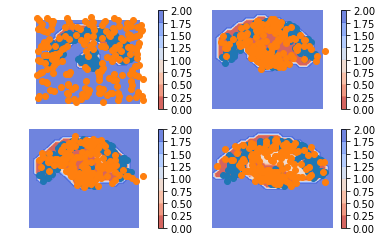

iteration  62
0.172984 0.0042949845 0.85610604 -0.68741703


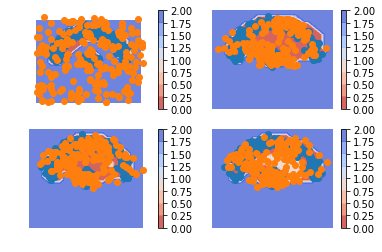

iteration  63
0.15734822 0.0041155657 0.80534524 -0.6521126


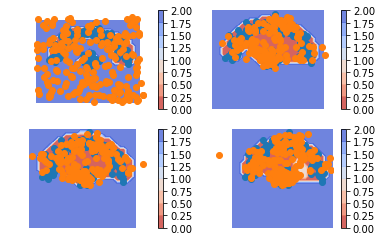

iteration  64
0.13703781 0.0039353142 0.80249083 -0.66938835


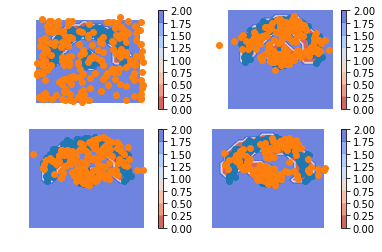

iteration  65
0.15971303 0.0040160217 0.80996597 -0.654269


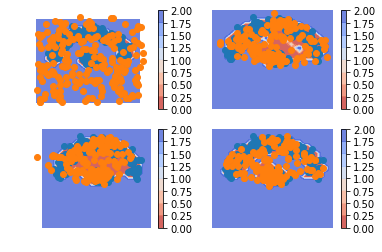

iteration  66
0.20013392 0.004180058 0.82154334 -0.6255895


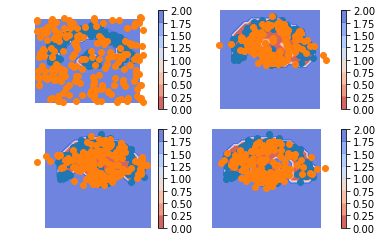

iteration  67
0.10441083 0.0046147625 0.8264935 -0.72669744


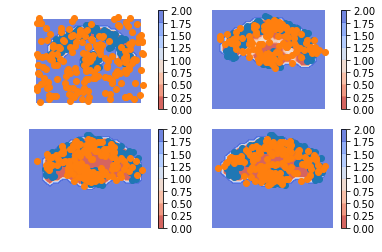

iteration  68
0.1366331 0.0051408974 0.7966448 -0.6651526


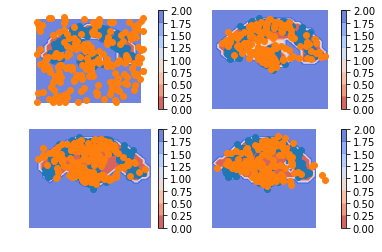

iteration  69
0.12913018 0.0055204253 0.8066243 -0.6830145


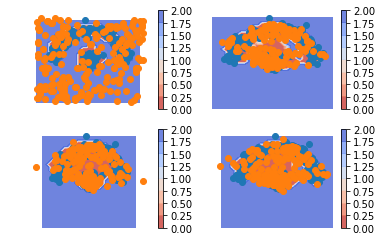

iteration  70
0.16265088 0.005901483 0.86186725 -0.7051178


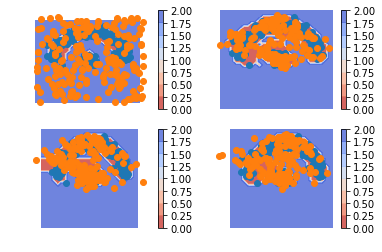

iteration  71
0.19770831 0.0055853613 0.795121 -0.6029981


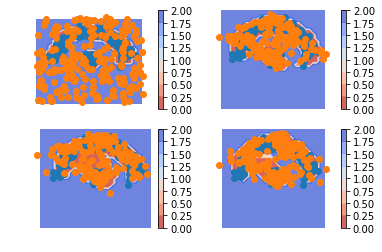

iteration  72
0.046957195 0.0046550496 0.79964733 -0.7573452


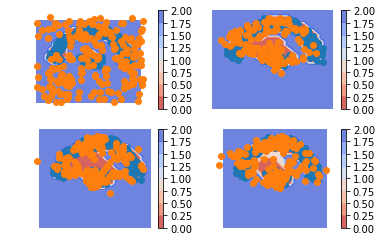

iteration  73
0.15934777 0.003783716 0.7862001 -0.63063604


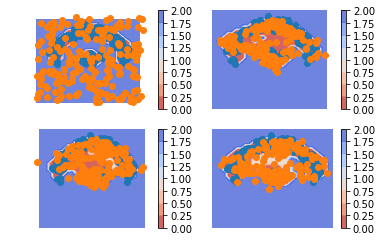

iteration  74
0.11118275 0.003826654 0.7860827 -0.6787266


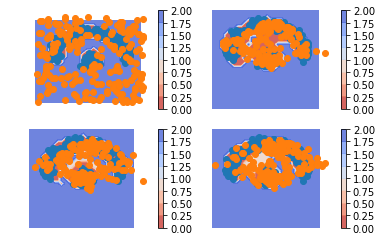

iteration  75
0.09487766 0.0045343665 0.813328 -0.72298473


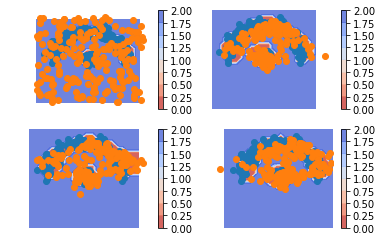

iteration  76
0.20636189 0.0052450527 0.8008508 -0.59973395


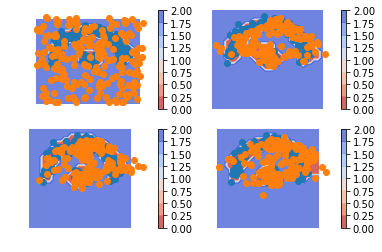

iteration  77
0.17003042 0.005562558 0.7933934 -0.6289255


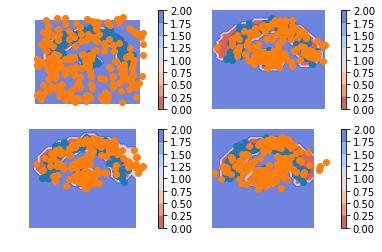

iteration  78
0.049868166 0.005508596 0.79737186 -0.7530123


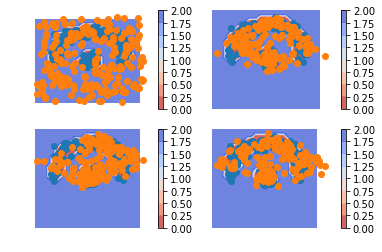

iteration  79
0.2062378 0.0055436296 0.80722183 -0.6065277


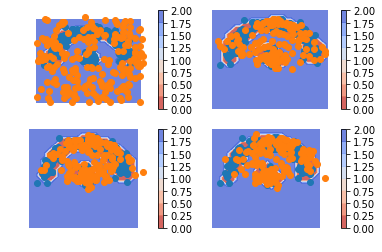

iteration  80
0.19923973 0.0055397465 0.8278614 -0.6341615


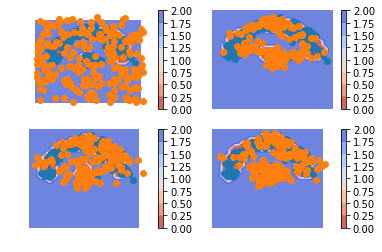

iteration  81
0.21699739 0.0053066136 0.8354292 -0.6237384


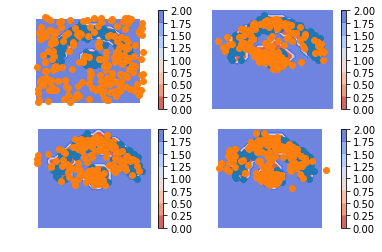

iteration  82
0.13400698 0.0054255724 0.77353 -0.6449486


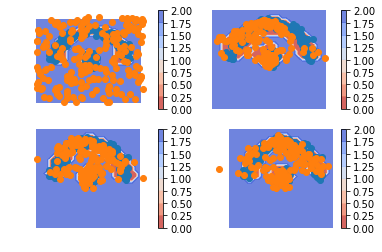

iteration  83
0.14105272 0.0058184057 0.81533766 -0.68010336


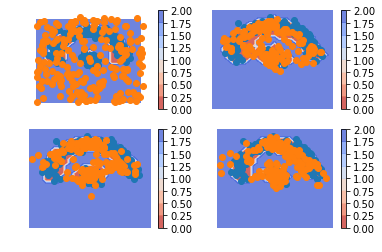

iteration  84
0.20963353 0.006641919 0.8027171 -0.5997255


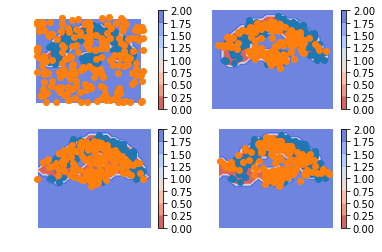

iteration  85
-0.0028072 0.0073248236 0.7869549 -0.7970869


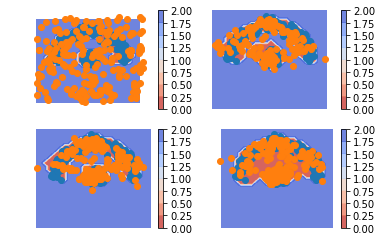

iteration  86
0.09659737 0.0077109323 0.76868355 -0.6797971


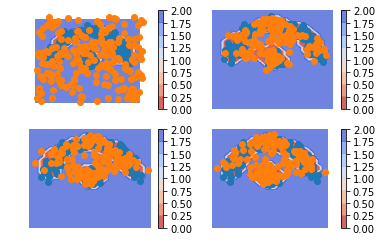

iteration  87
0.14970326 0.007463676 0.8049652 -0.6627256


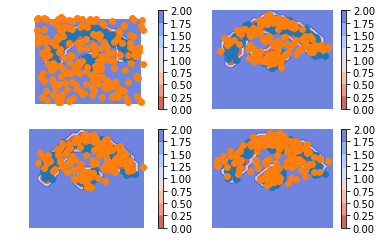

iteration  88
0.1808269 0.0067829345 0.7927935 -0.61874956


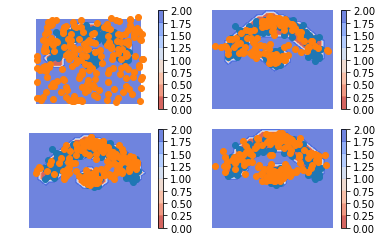

iteration  89
0.19609249 0.006253826 0.7984336 -0.60859495


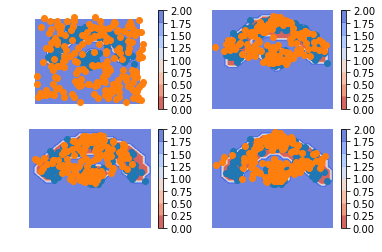

iteration  90
0.12642413 0.005345582 0.8243092 -0.7032306


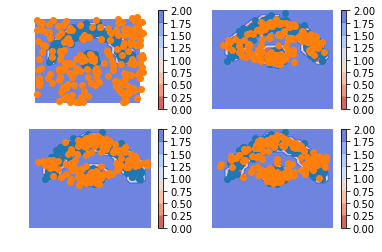

iteration  91
0.1749515 0.0044399286 0.8167859 -0.6462743


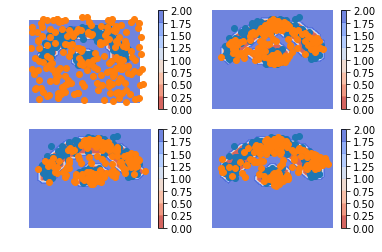

iteration  92
0.13368237 0.003700744 0.834323 -0.70434135


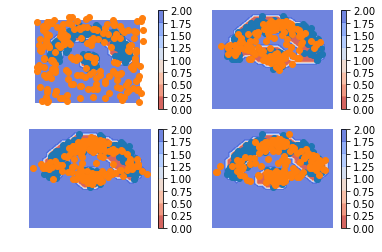

iteration  93
0.0569551 0.0035433944 0.7987936 -0.7453819


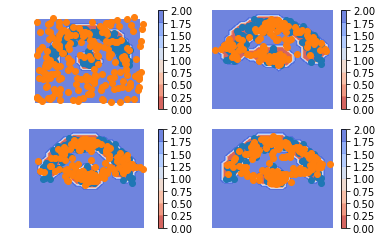

iteration  94
0.12347442 0.003671881 0.79957795 -0.6797754


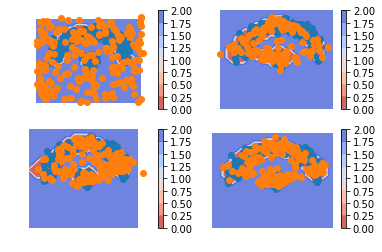

iteration  95
0.11394173 0.004254913 0.8249618 -0.715275


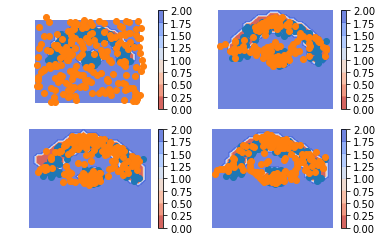

iteration  96
0.2601431 0.0049780197 0.8432419 -0.5880768


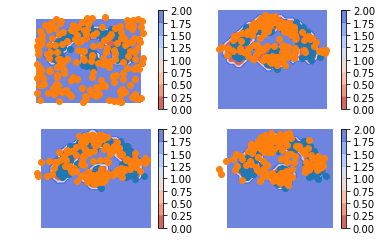

iteration  97
0.16498923 0.0049859746 0.8055418 -0.64553857


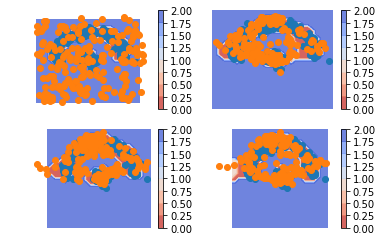

iteration  98
0.20039421 0.0047630034 0.81568074 -0.62004954


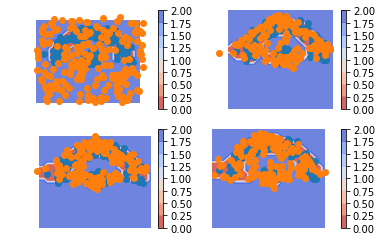

iteration  99
0.12624663 0.004669657 0.83472824 -0.7131513


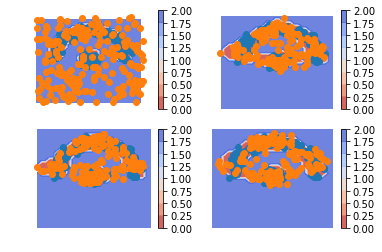

iteration  100
0.23892963 0.0045515476 0.8160247 -0.5816466


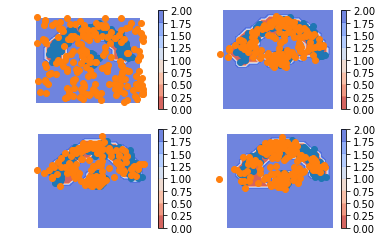

iteration  101
0.1221323 0.004099957 0.81603056 -0.6979982


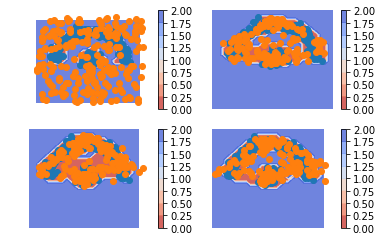

iteration  102
0.16352642 0.003944417 0.85616446 -0.69658244


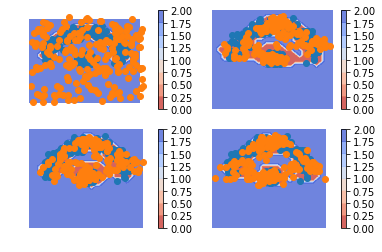

iteration  103
0.17392254 0.003383781 0.8265345 -0.6559957


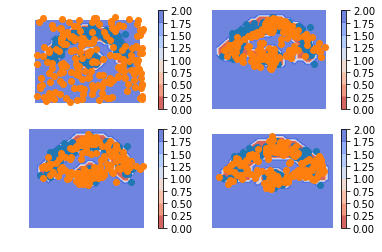

iteration  104
0.07634997 0.0027332855 0.80692744 -0.73331076


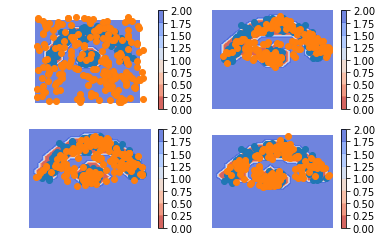

iteration  105
0.033676147 0.0025124773 0.8099247 -0.778761


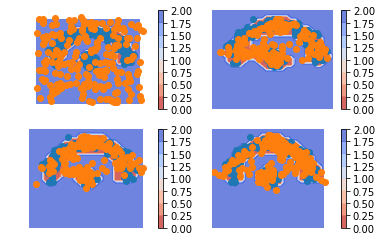

iteration  106
0.011368036 0.0022553436 0.8151494 -0.8060367


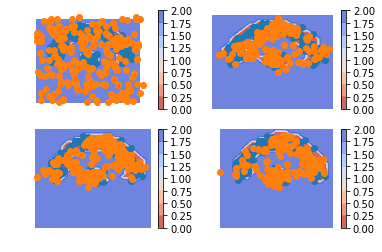

iteration  107
0.1624884 0.002233958 0.80262184 -0.6423674


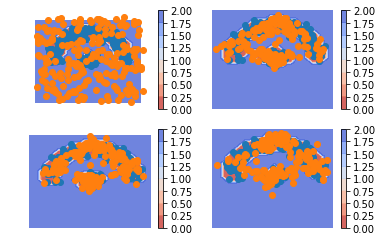

iteration  108
0.07486516 0.002321297 0.8069406 -0.73439676


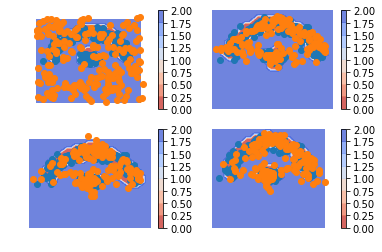

iteration  109
0.15391684 0.0025334747 0.8055606 -0.65417725


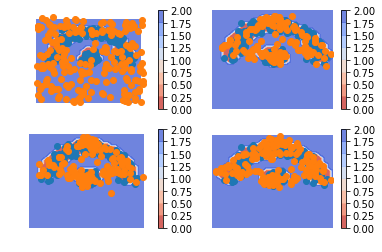

iteration  110
0.08623636 0.0026100164 0.82260025 -0.7389739


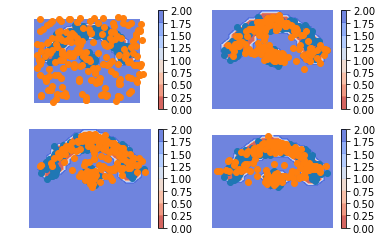

iteration  111
0.15098041 0.0028176096 0.8299835 -0.6818207


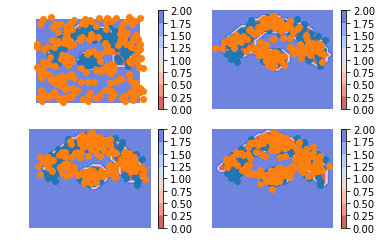

iteration  112
0.079954326 0.0030008072 0.8146936 -0.7377401


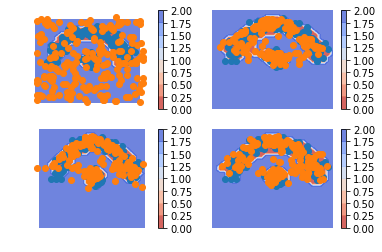

iteration  113
0.052729607 0.0031534194 0.79400426 -0.7444281


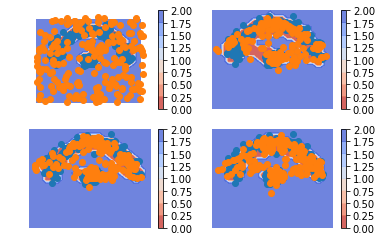

iteration  114
0.06619042 0.0033619995 0.8038542 -0.7410258


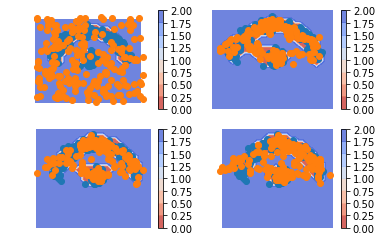

iteration  115
0.10818291 0.0034915989 0.81265235 -0.707961


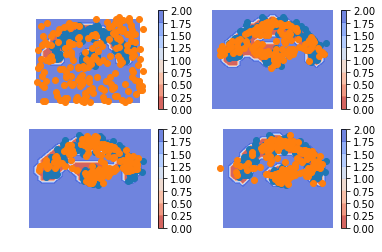

iteration  116
0.08740586 0.0033409428 0.76994216 -0.68587726


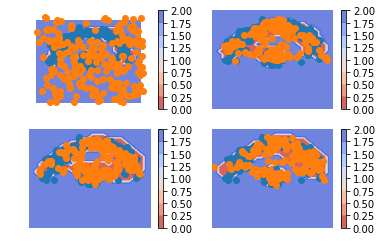

iteration  117
0.0531016 0.0030818395 0.83458626 -0.7845665


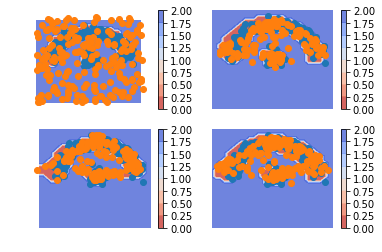

iteration  118
0.13124567 0.0029976037 0.8151572 -0.6869091


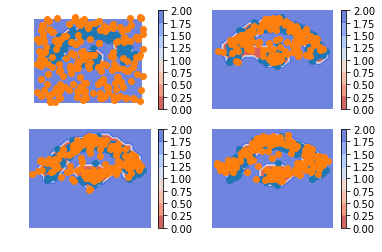

iteration  119
0.16292298 0.0026651735 0.84394336 -0.68368554


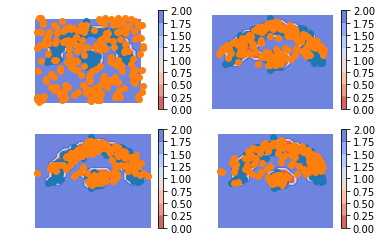

iteration  120
0.07625306 0.0024344586 0.8043031 -0.7304845


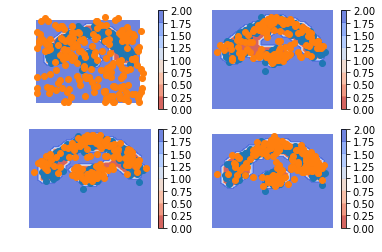

iteration  121
-0.006209731 0.002130039 0.80180585 -0.8101456


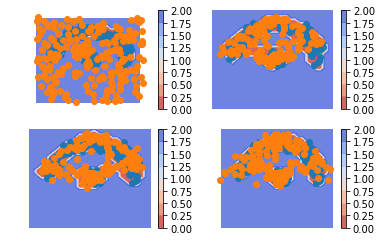

iteration  122
0.07405257 0.0020778489 0.81185335 -0.73987865


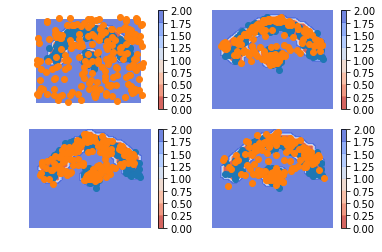

iteration  123
0.05598116 0.0020210515 0.7956591 -0.74169904


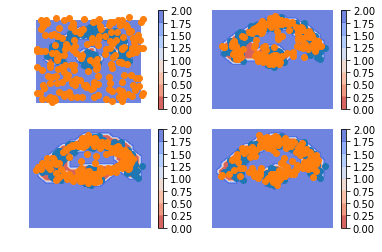

iteration  124
0.067681074 0.0019436881 0.79297227 -0.7272349


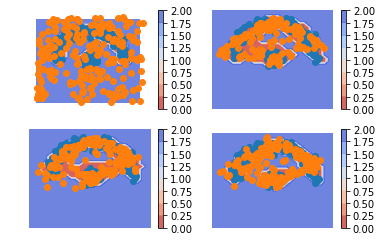

iteration  125
0.07926613 0.0018770858 0.7896825 -0.71229345


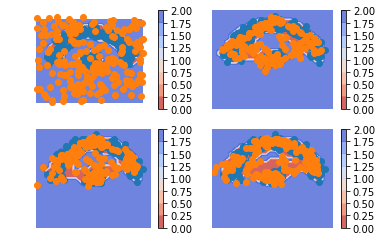

iteration  126
-0.066680074 0.0017947836 0.7780036 -0.8464784


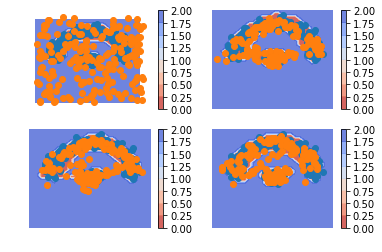

iteration  127
0.021992683 0.0019708006 0.7715927 -0.7515708


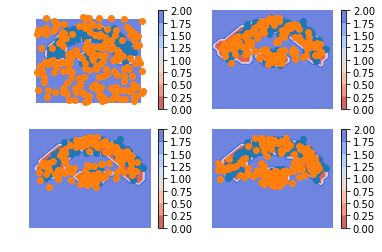

iteration  128
0.05483502 0.0022942526 0.84267503 -0.79013425


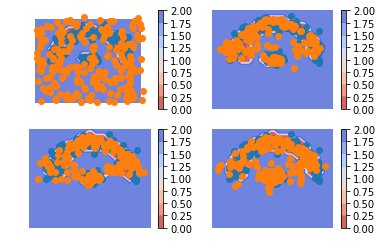

iteration  129
0.16677237 0.0026352343 0.81629115 -0.652154


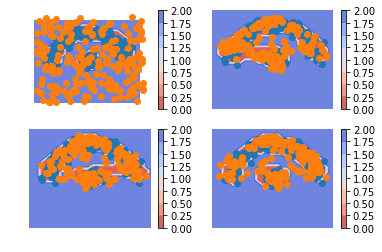

iteration  130
-0.007649839 0.0028865172 0.7877586 -0.79829496


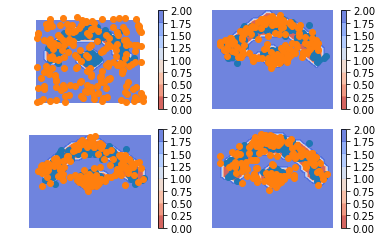

iteration  131
0.11081785 0.0028984025 0.8173207 -0.70940125


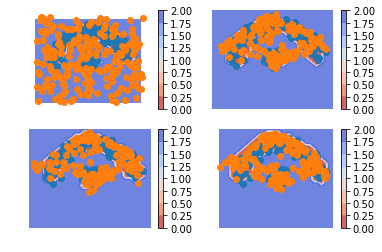

iteration  132
0.0585137 0.0028209938 0.79079914 -0.7351064


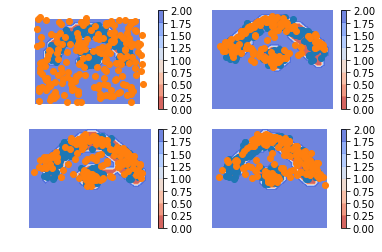

iteration  133
0.000756979 0.0023092213 0.7976261 -0.7991783


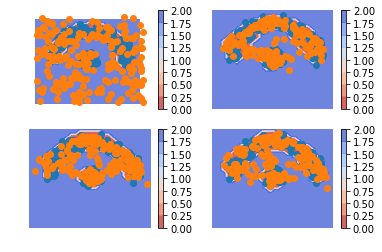

iteration  134
0.06622881 0.0019849304 0.81127834 -0.7470345


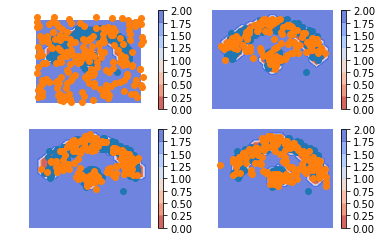

iteration  135
0.06987488 0.0018656476 0.8175047 -0.74949545


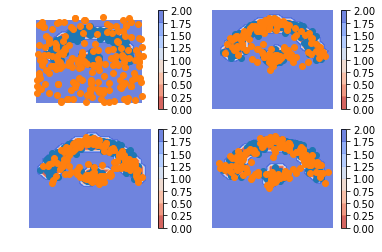

iteration  136
0.099457085 0.0018075069 0.7711463 -0.6734967


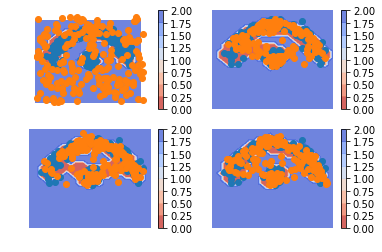

iteration  137
0.0011096001 0.0017522987 0.8210651 -0.82170784


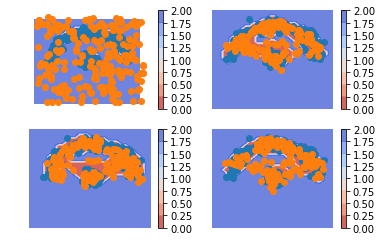

iteration  138
0.12814724 0.0015958615 0.8363048 -0.7097534


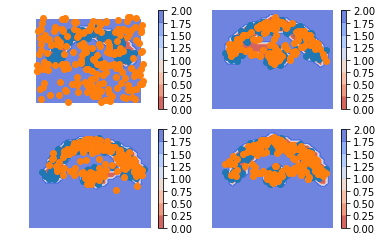

iteration  139
0.04209739 0.001811989 0.83027303 -0.7899876


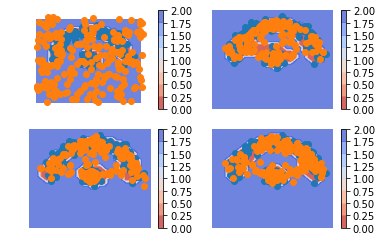

iteration  140
0.017850757 0.0021539084 0.80298877 -0.78729194


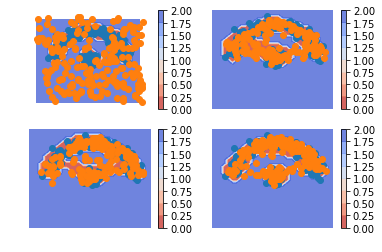

iteration  141
-0.041888773 0.0026818537 0.80590475 -0.8504754


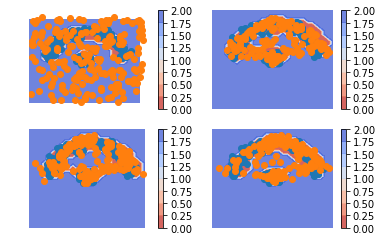

iteration  142
0.10661918 0.003086774 0.81551945 -0.711987


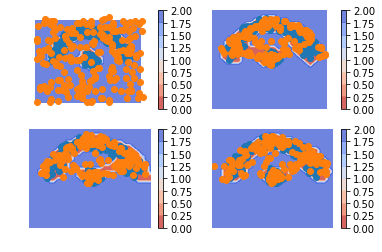

iteration  143
0.0353958 0.0033144557 0.7987968 -0.7667154


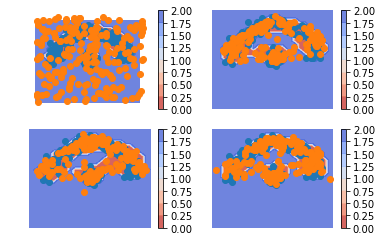

iteration  144
0.08221096 0.0032725844 0.83131534 -0.752377


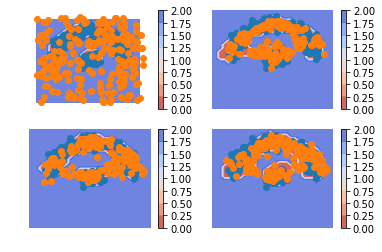

iteration  145
0.021014094 0.0031967089 0.7939426 -0.7761252


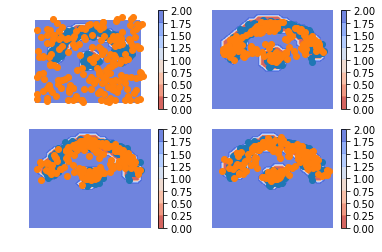

iteration  146
0.038075566 0.0031160736 0.8152487 -0.78028923


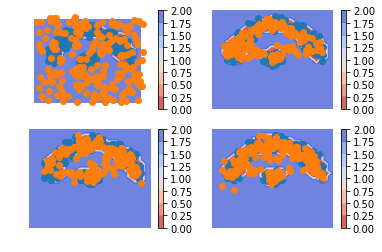

iteration  147
0.04707688 0.002936636 0.79287046 -0.74873024


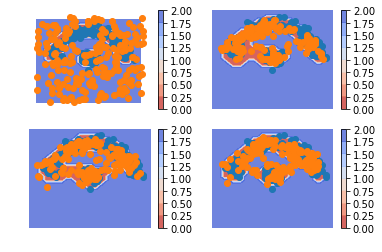

iteration  148
0.037478745 0.0028598532 0.79350114 -0.7588822


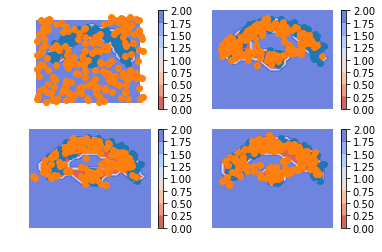

iteration  149
0.0073322654 0.002662731 0.82196444 -0.8172949


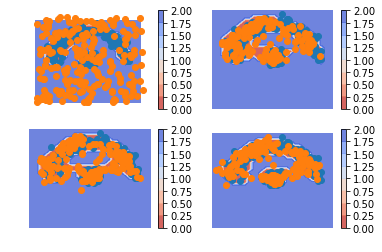

iteration  150
-0.009599388 0.002557774 0.7970511 -0.8092082


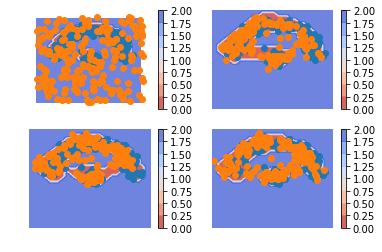

iteration  151
0.058223963 0.0024604641 0.799296 -0.74353254


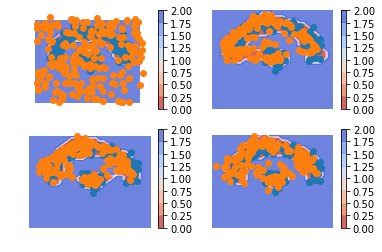

iteration  152
0.089645505 0.002573275 0.8237378 -0.73666555


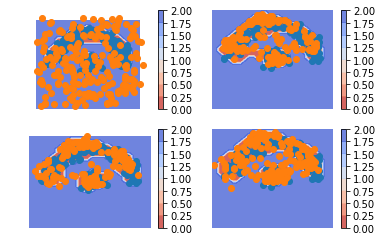

iteration  153
0.07104713 0.0024706756 0.81478465 -0.7462082


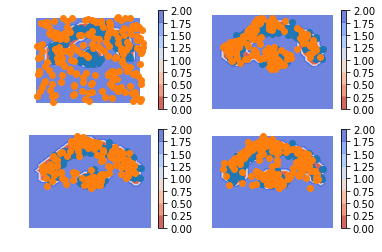

iteration  154
0.0031935573 0.002507882 0.7712251 -0.7705394


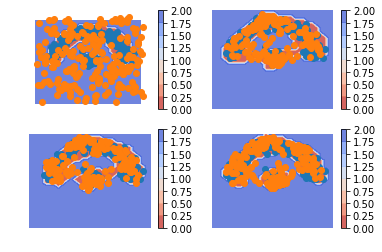

iteration  155
-0.021155834 0.0029386024 0.7961996 -0.8202941


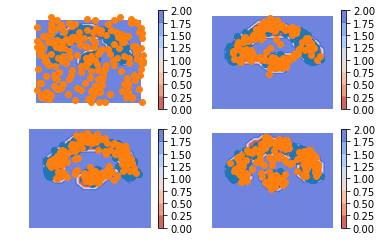

iteration  156
0.095078886 0.0034461296 0.8162018 -0.724569


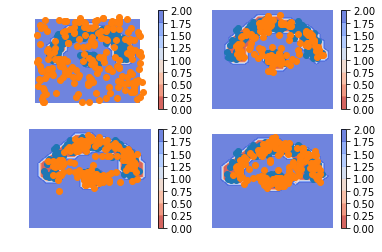

iteration  157
0.12147635 0.0040902183 0.7771145 -0.65972835


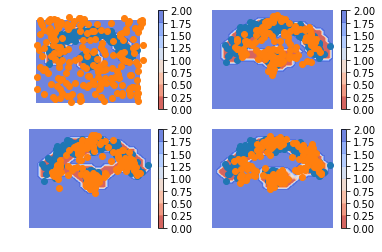

iteration  158
0.119832575 0.0046645915 0.78551173 -0.67034376


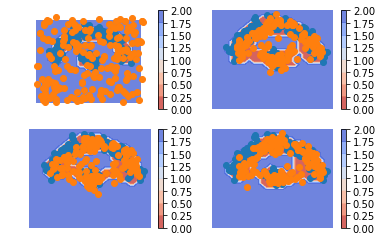

iteration  159
-0.008340776 0.0047815857 0.80756855 -0.82069093


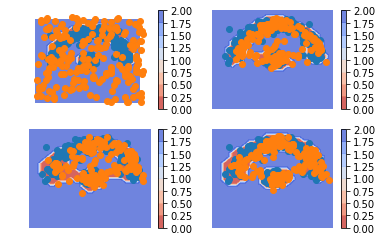

iteration  160
0.05156094 0.004886027 0.8131985 -0.7665236


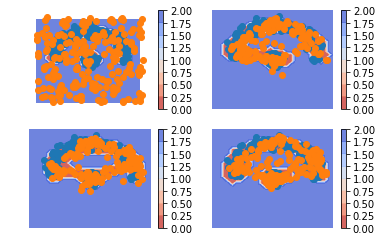

iteration  161
0.038321733 0.004689432 0.82623965 -0.79260737


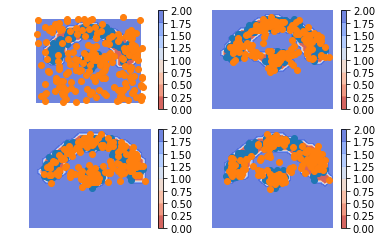

iteration  162
0.0073236823 0.0045951367 0.8195543 -0.8168258


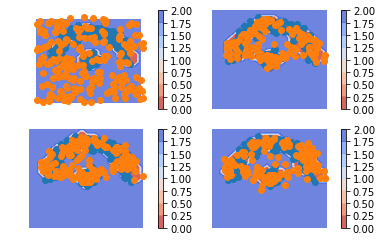

iteration  163
0.073176146 0.004524153 0.80077624 -0.73212427


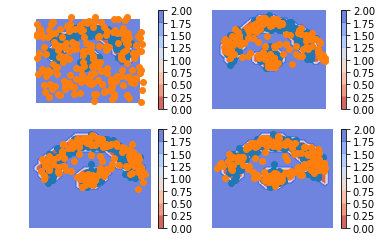

iteration  164
0.05426991 0.0044839513 0.8097106 -0.75992465


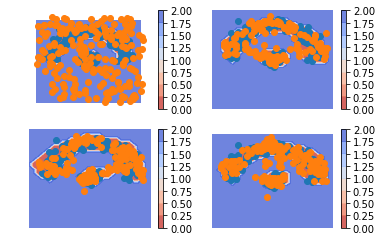

iteration  165
0.12192607 0.004007266 0.8073068 -0.68938804


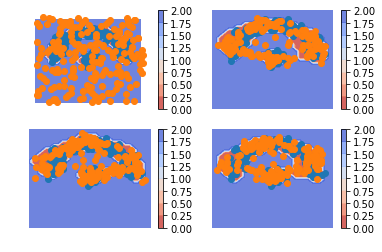

iteration  166
0.06528324 0.0033301017 0.8079798 -0.7460267


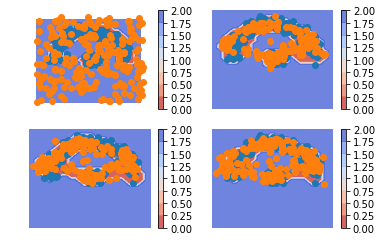

iteration  167
0.038104236 0.0025110755 0.8144462 -0.77885306


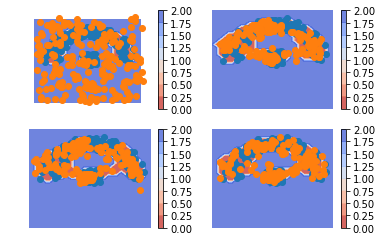

iteration  168
0.0097055435 0.0019433515 0.78000736 -0.77224517


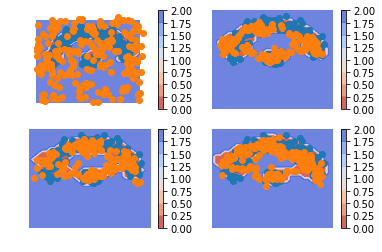

iteration  169
-0.0112038255 0.001888816 0.79622096 -0.8093136


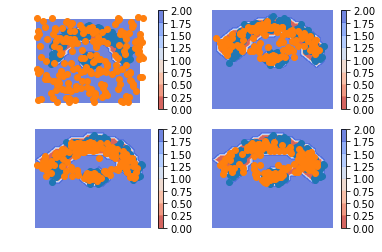

iteration  170
-0.04257828 0.0022784746 0.78287685 -0.8277336


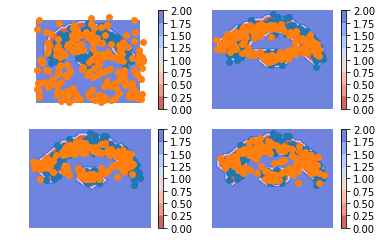

iteration  171
-0.058920562 0.0026125312 0.7900382 -0.8515713


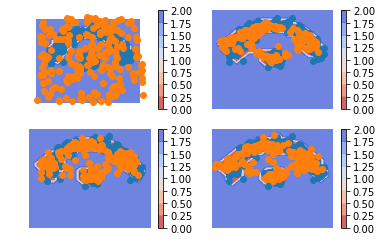

iteration  172
0.00917393 0.0032642863 0.80857646 -0.80266684


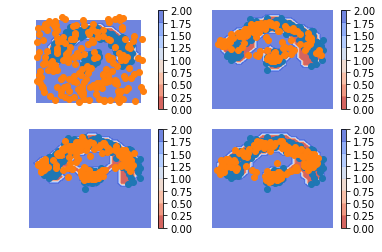

iteration  173
-0.04311472 0.0039575202 0.80863535 -0.8557076


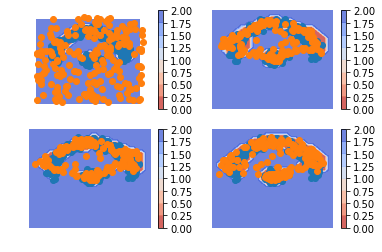

iteration  174
0.065617025 0.0047440054 0.75608724 -0.6952142


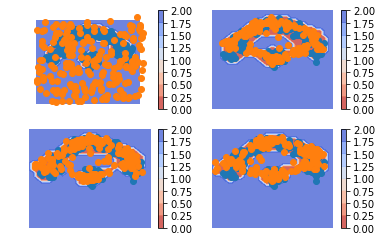

iteration  175
0.06794655 0.0050707557 0.83888745 -0.77601165


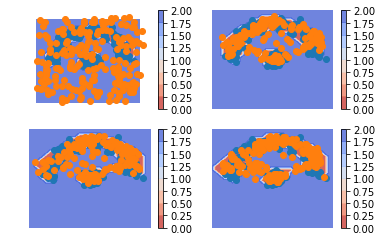

iteration  176
0.032439888 0.0050896364 0.7780026 -0.7506524


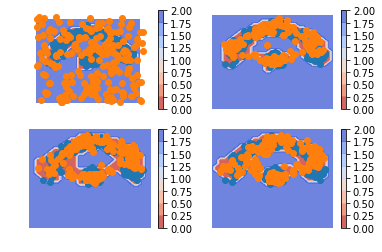

iteration  177
-0.02235794 0.0049750856 0.80737126 -0.8347043


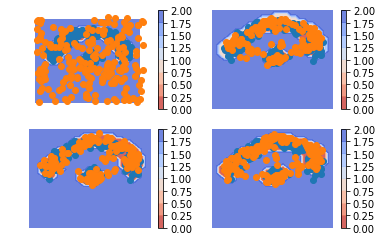

iteration  178
0.25899476 0.0045566224 0.8022937 -0.54785556


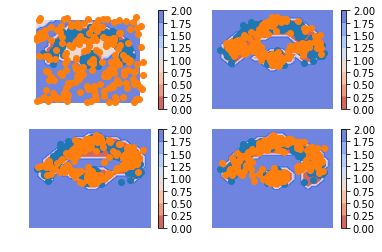

iteration  179
0.24768269 0.003917023 0.79554546 -0.5517798


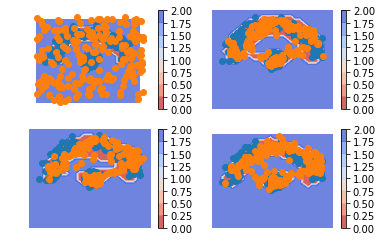

iteration  180
0.07253575 0.0032477346 0.8055735 -0.7362855


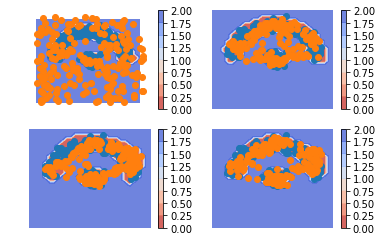

iteration  181
0.07986045 0.0026996853 0.806213 -0.72905225


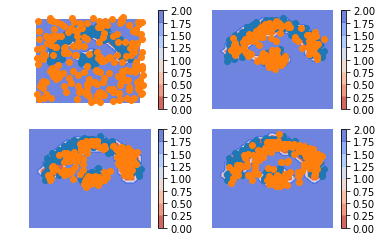

iteration  182
0.14002836 0.0023316978 0.80338776 -0.6656911


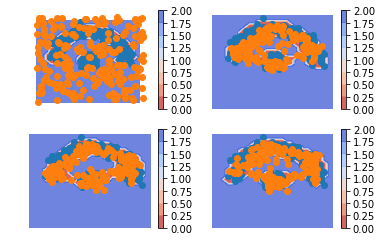

iteration  183
0.0380795 0.0020549954 0.7846954 -0.7486709


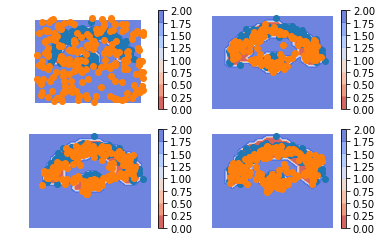

iteration  184
0.024845123 0.0019139675 0.80481875 -0.7818876


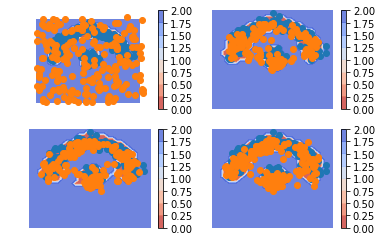

iteration  185
-0.009255528 0.0017925572 0.8103056 -0.8213537


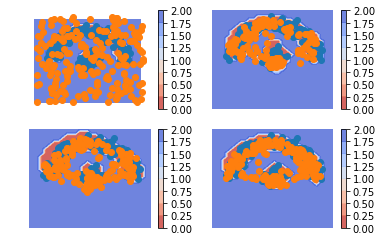

iteration  186
0.10621452 0.0017057084 0.82334393 -0.7188351


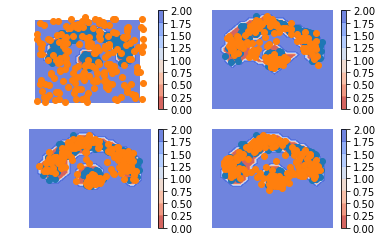

iteration  187
0.011523962 0.001894243 0.77581704 -0.7661873


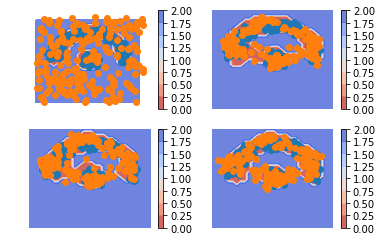

iteration  188
0.044098973 0.0022521825 0.8124009 -0.77055407


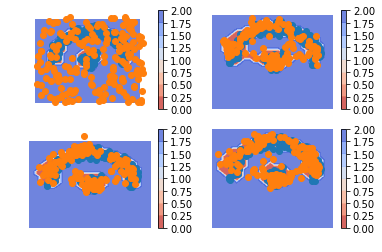

iteration  189
0.098453104 0.002823961 0.8463699 -0.75074077


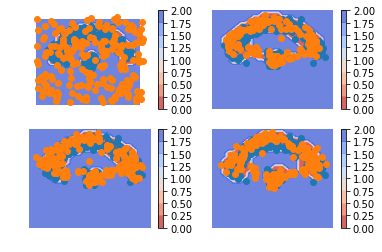

iteration  190
0.08756906 0.0035019754 0.8455765 -0.7615094


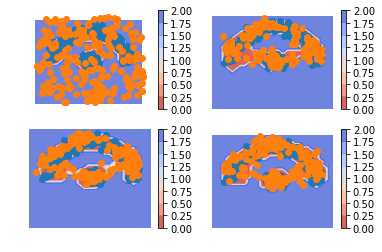

iteration  191
0.12999535 0.0040619196 0.79594994 -0.6700165


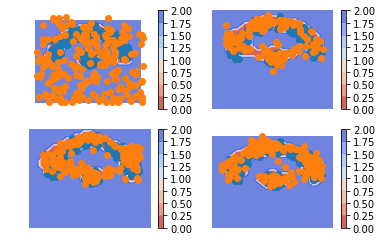

iteration  192
0.06993163 0.004538913 0.7997463 -0.73435354


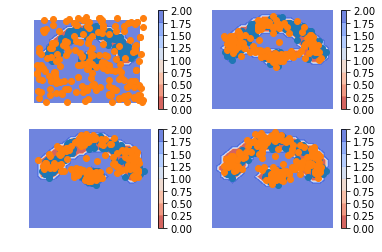

iteration  193
-0.0044608116 0.004816344 0.8203705 -0.82964766


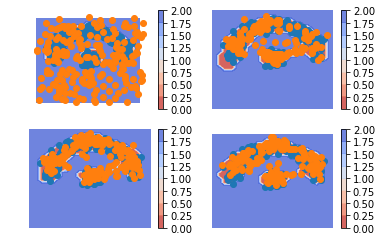

iteration  194
0.033452094 0.0047140634 0.80629265 -0.77755463


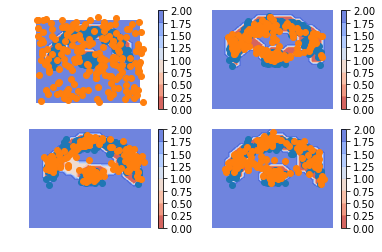

iteration  195
0.007964551 0.004493438 0.79011714 -0.786646


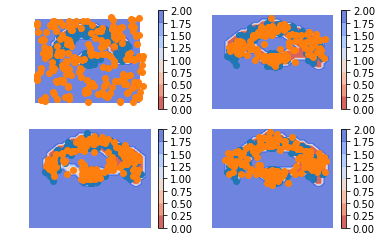

iteration  196
0.013534129 0.0041808193 0.7875948 -0.7782415


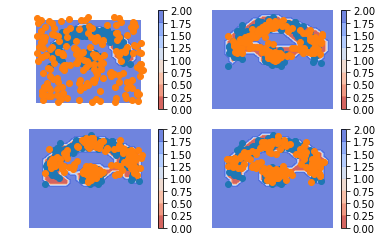

iteration  197
-0.008031249 0.0038122558 0.7784711 -0.7903146


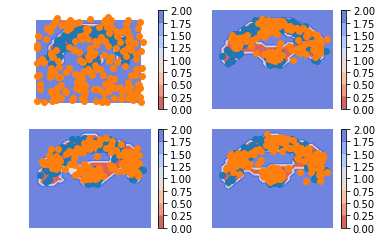

iteration  198
-0.03613007 0.003606937 0.78175664 -0.8214936


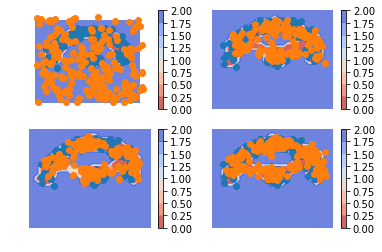

iteration  199
-0.055449605 0.003391123 0.7986866 -0.8575274


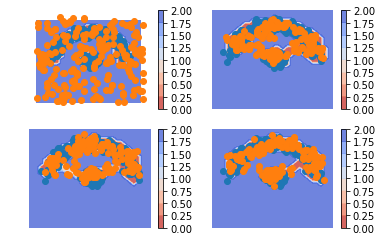

iteration  200
-0.00038540363 0.0034292268 0.80561936 -0.809434


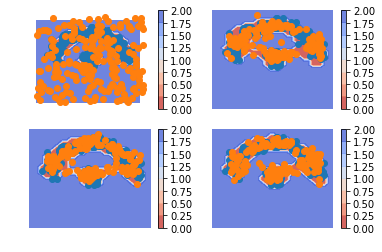

iteration  201
0.036311507 0.00365841 0.79565865 -0.76300555


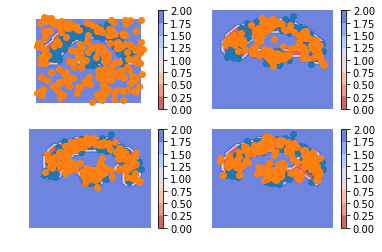

iteration  202
0.054094434 0.004119466 0.77274454 -0.72276956


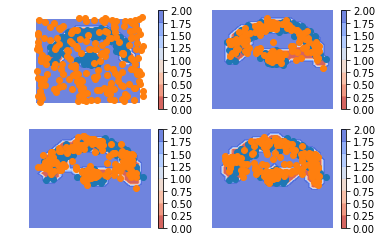

iteration  203
0.025159001 0.0045737154 0.8028356 -0.7822503


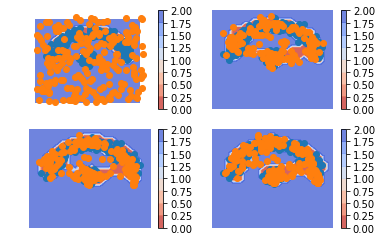

iteration  204
0.019407034 0.0043625394 0.8031142 -0.78806967


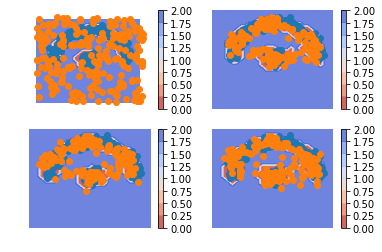

iteration  205
0.024072945 0.0038118493 0.8373468 -0.8170857


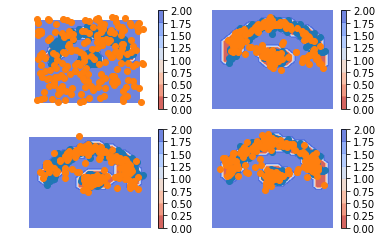

iteration  206
0.059993565 0.003047571 0.82183135 -0.76488537


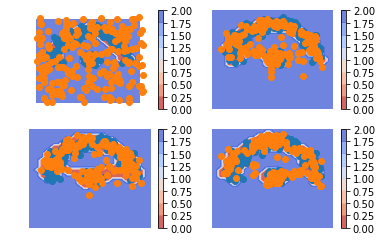

iteration  207
0.1518076 0.0023594457 0.8100263 -0.66057813


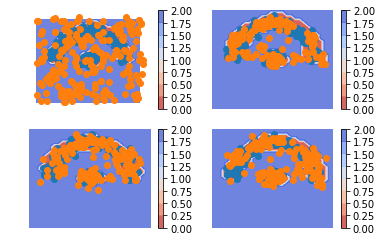

iteration  208
0.04720509 0.0018902643 0.7863038 -0.74098897


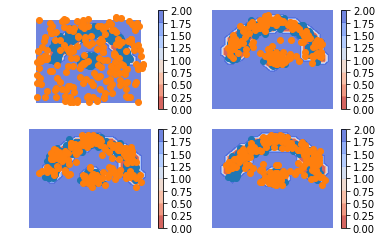

iteration  209
0.02629596 0.0019055174 0.83683145 -0.812441


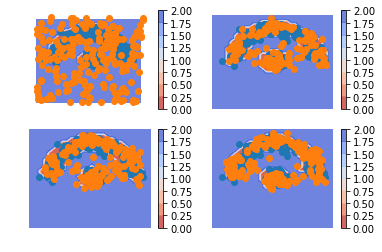

iteration  210
0.05191624 0.0023951267 0.8475908 -0.7980697


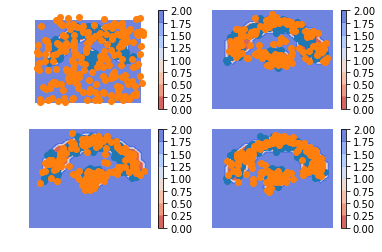

iteration  211
0.07057166 0.0032746894 0.8124376 -0.7451406


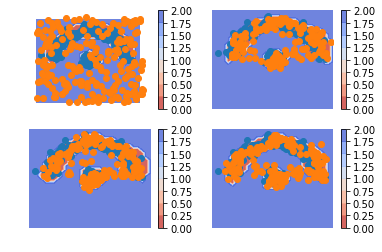

iteration  212
-0.095689535 0.0040677353 0.80848384 -0.9082411


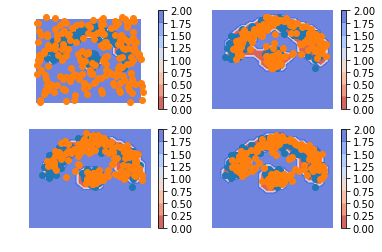

iteration  213
0.107586026 0.0047679995 0.7943686 -0.6915506


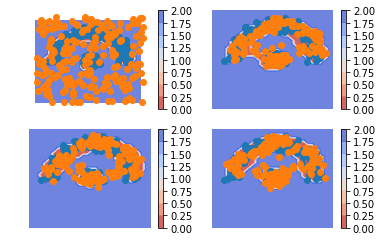

iteration  214
0.08137721 0.0058733467 0.7908541 -0.7153502


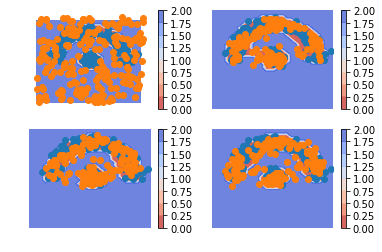

iteration  215
-0.0832451 0.0067571043 0.779114 -0.8691162


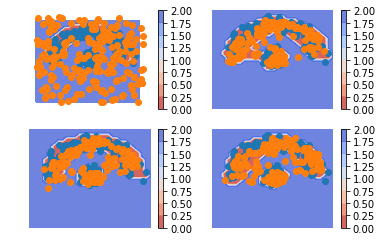

iteration  216
-0.07381648 0.007645248 0.7816706 -0.8631323


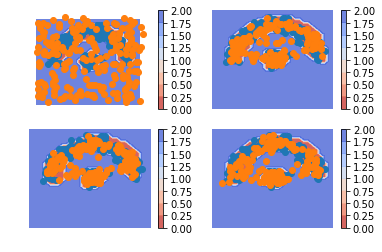

iteration  217
-0.0041350126 0.008177165 0.7944947 -0.80680686


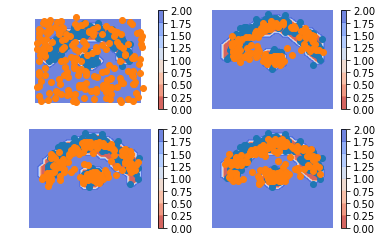

iteration  218
-0.039876938 0.008515317 0.7653246 -0.8137168


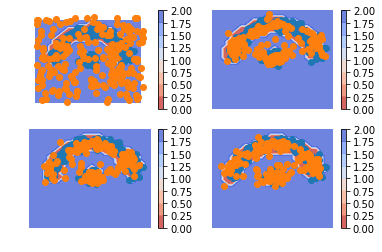

iteration  219
-0.033747613 0.00851655 0.81992173 -0.8621859


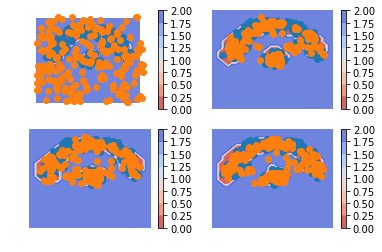

iteration  220
-0.018104374 0.00879485 0.8192754 -0.8461746


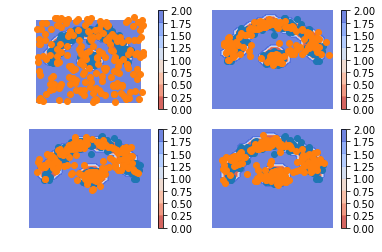

iteration  221
0.023038566 0.008759932 0.81766397 -0.8033853


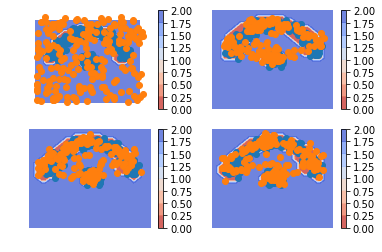

iteration  222
-0.0007289052 0.008062992 0.79590476 -0.8046967


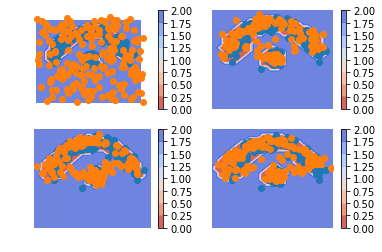

iteration  223
-0.0028846264 0.007728327 0.75679845 -0.7674114


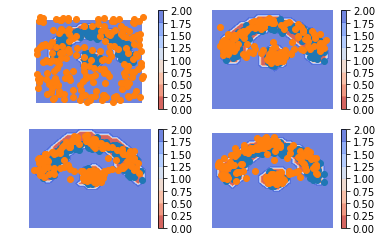

iteration  224
0.013221383 0.007125279 0.80151564 -0.7954195


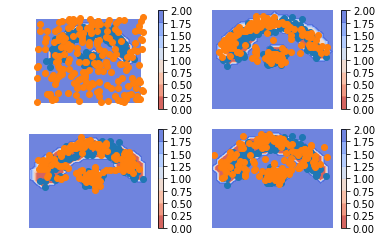

iteration  225
0.28256357 0.0065074856 0.77573854 -0.49968243


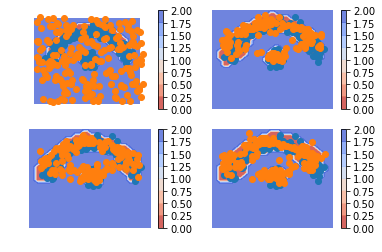

iteration  226
0.11212206 0.005527209 0.7799952 -0.67340034


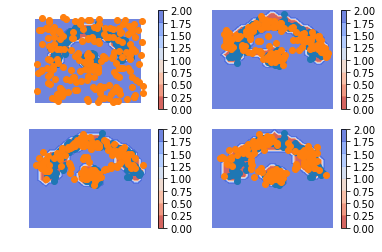

iteration  227
0.041605234 0.004886203 0.81518567 -0.77846664


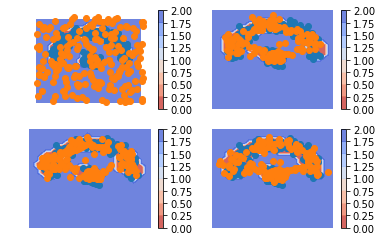

iteration  228
0.065600336 0.004504761 0.8395052 -0.7784096


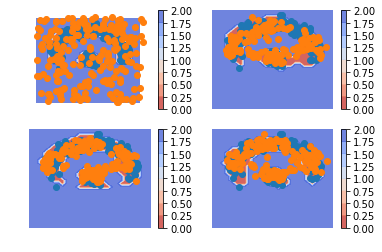

iteration  229
0.064475 0.00411814 0.821162 -0.76080513


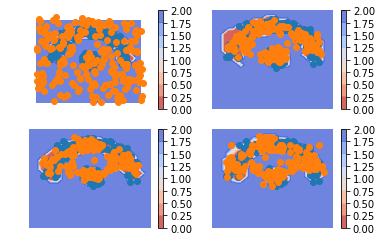

iteration  230
0.15493321 0.0037900484 0.8042402 -0.65309703


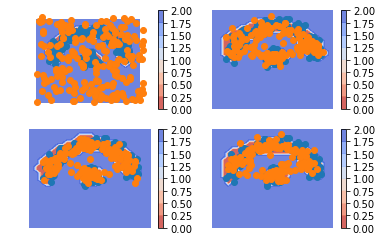

iteration  231
0.04624772 0.0036672258 0.78807354 -0.74549305


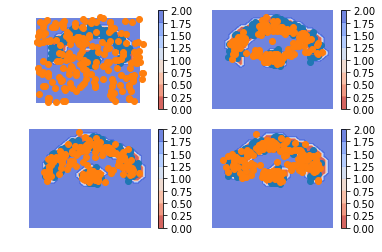

iteration  232
-0.07529336 0.0035469476 0.76205707 -0.8408974


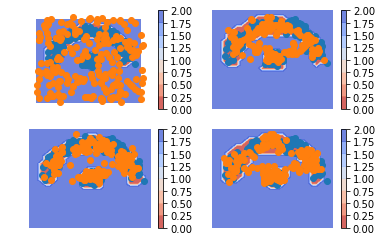

iteration  233
-0.06882948 0.003730595 0.81538475 -0.8879448


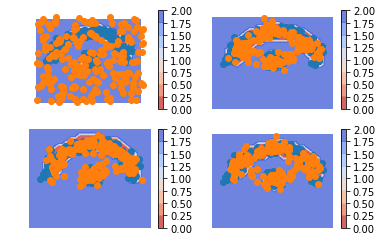

iteration  234
-0.009159803 0.003948295 0.81436396 -0.82747203


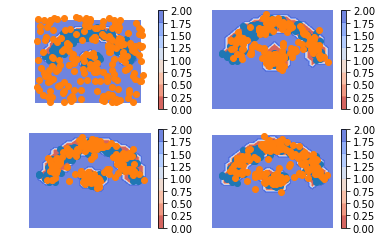

iteration  235
0.038728535 0.004629978 0.84303427 -0.8089357


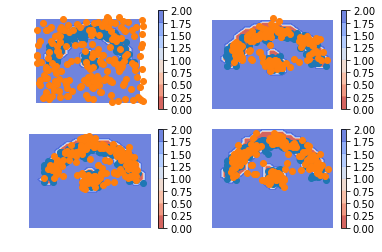

iteration  236
0.05891186 0.0056959707 0.81925255 -0.7660367


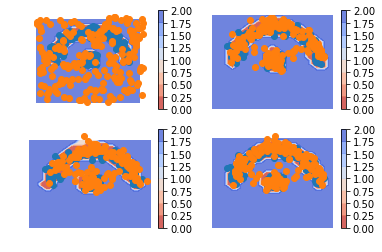

iteration  237
0.070191145 0.0072553474 0.8049109 -0.7419751


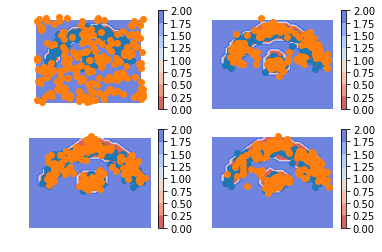

iteration  238
-0.013644695 0.008575595 0.78837305 -0.81059337


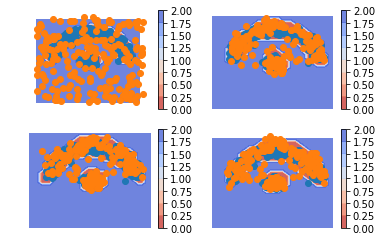

iteration  239
-0.017054379 0.009406771 0.8209122 -0.8473733


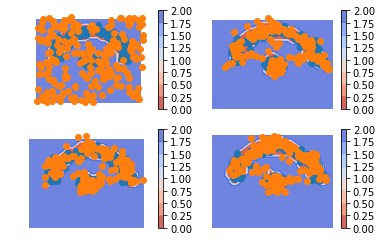

iteration  240
0.0221048 0.009996411 0.816926 -0.8048176


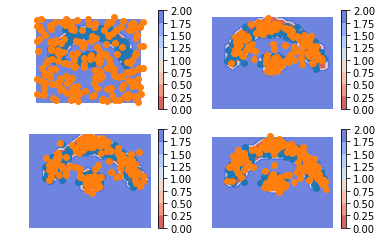

iteration  241
-0.0066957474 0.010643115 0.79938203 -0.8167209


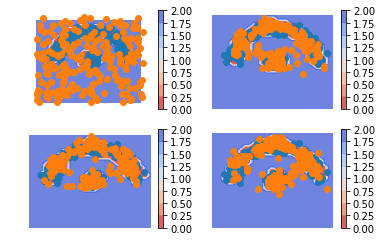

iteration  242
-0.041210234 0.010811755 0.8086382 -0.8606602


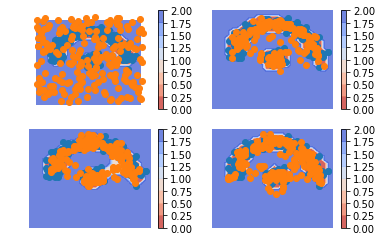

iteration  243
0.03882885 0.009665464 0.78458905 -0.7554257


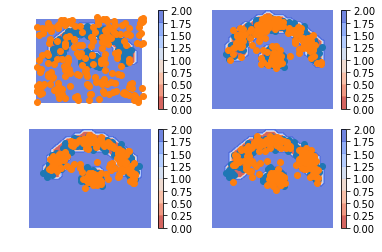

iteration  244
0.03590375 0.007687497 0.8072674 -0.7790512


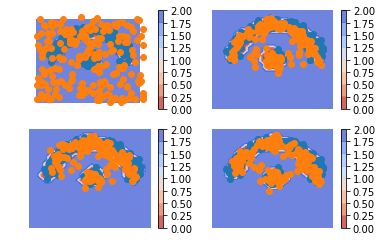

iteration  245
-0.007418394 0.006012934 0.7988411 -0.8122724


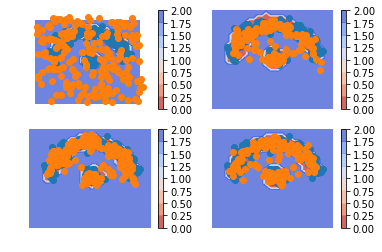

iteration  246
0.008480549 0.0049796095 0.81090397 -0.807403


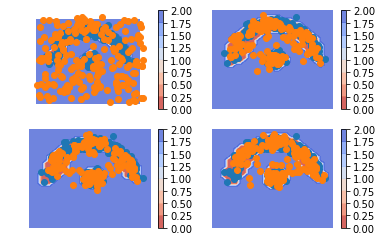

iteration  247
-0.015939415 0.0049941493 0.80320007 -0.82413363


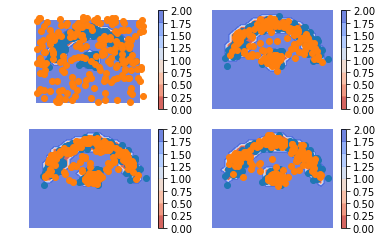

iteration  248
-0.051092386 0.0057970523 0.7986894 -0.85557884


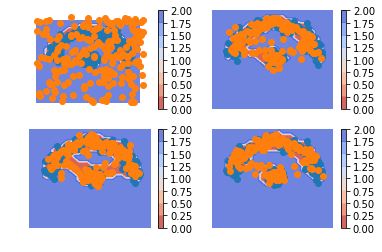

iteration  249
1.8775463e-05 0.006668272 0.8240879 -0.8307374


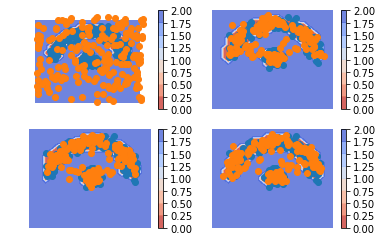

iteration  250
-0.004824996 0.00749835 0.79097986 -0.8033032


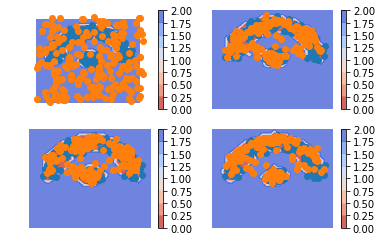

iteration  251
-0.100290895 0.008280315 0.8193258 -0.92789704


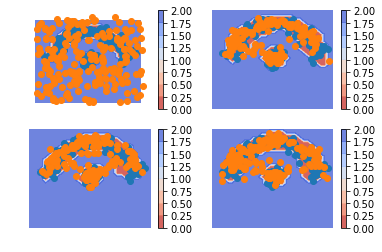

iteration  252
-0.014996469 0.008624074 0.7873211 -0.81094164


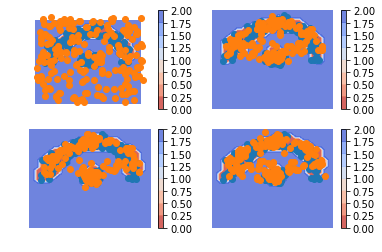

iteration  253
-0.05117935 0.008095922 0.797692 -0.8569673


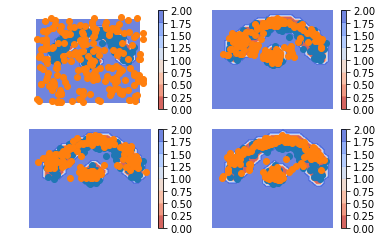

iteration  254
-0.04231745 0.0072894106 0.80193764 -0.8515445


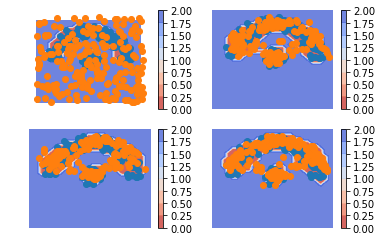

iteration  255
-0.0058103204 0.006407354 0.82761866 -0.83983636


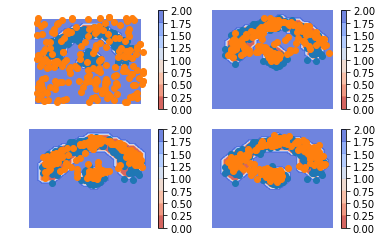

iteration  256
-0.08565915 0.0053752325 0.75687313 -0.8479075


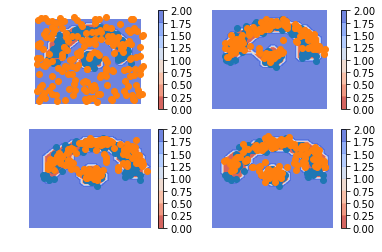

iteration  257
-0.033334255 0.004613136 0.7979151 -0.8358625


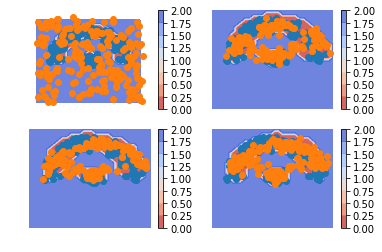

iteration  258
-0.01736617 0.0040786252 0.83645886 -0.85790366


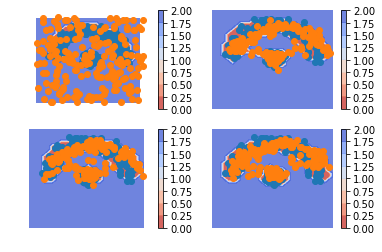

iteration  259
0.015568912 0.0037397933 0.8033699 -0.79154074


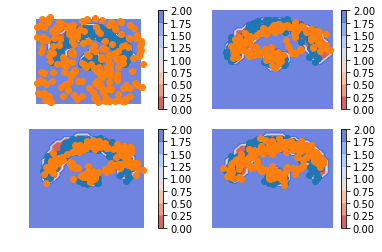

iteration  260
-0.051110327 0.0039138836 0.8392849 -0.8943091


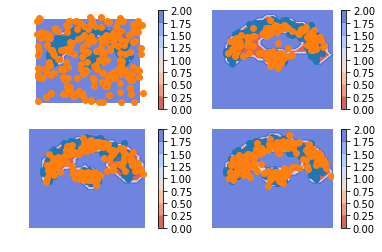

iteration  261
0.037792385 0.004253628 0.8255738 -0.79203504


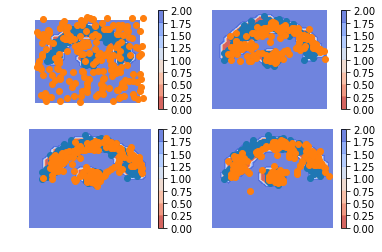

iteration  262
-0.017515302 0.004629873 0.8009907 -0.82313585


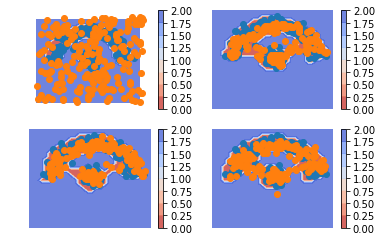

iteration  263
-0.07549995 0.0049300063 0.7946498 -0.87507975


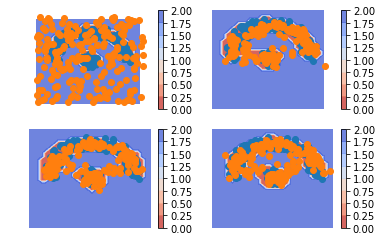

iteration  264
0.006128311 0.0050614085 0.8410135 -0.83994657


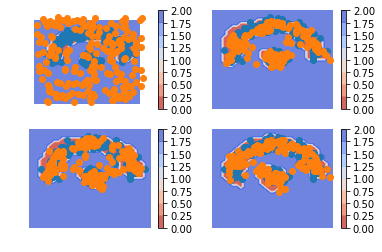

iteration  265
-0.016738296 0.005075261 0.79165816 -0.81347173


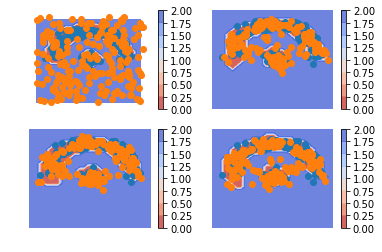

iteration  266
0.017692804 0.005047965 0.81751007 -0.80486524


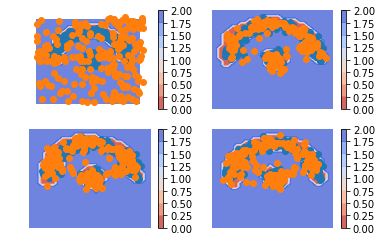

iteration  267
0.021014929 0.0050422675 0.7916235 -0.7756508


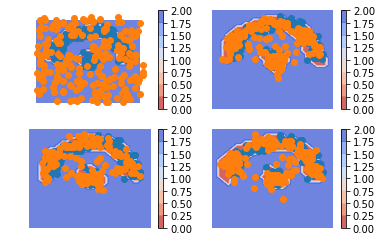

iteration  268
0.016663909 0.0044248104 0.83188003 -0.81964093


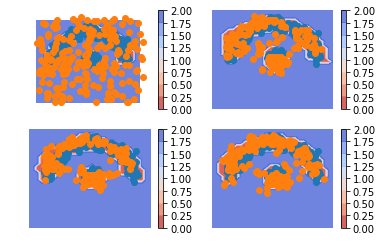

iteration  269
0.043623626 0.0036513647 0.8142048 -0.77423257


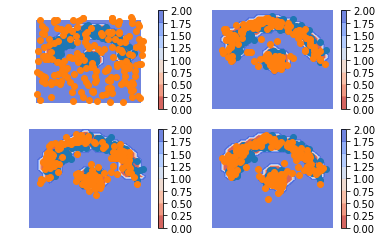

iteration  270
0.008367002 0.0027165061 0.8213197 -0.8156692


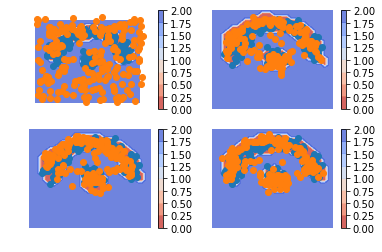

iteration  271
0.037144482 0.0019505265 0.810302 -0.77510804


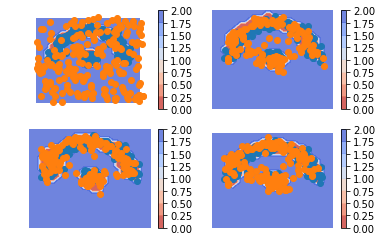

iteration  272
-0.05280596 0.0016779518 0.8061458 -0.8606297


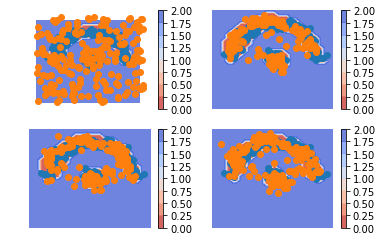

iteration  273
0.008204937 0.00181789 0.79632497 -0.7899379


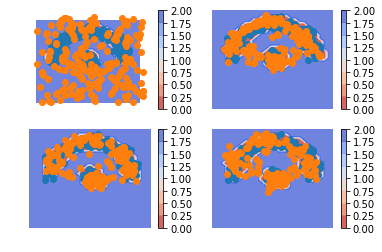

iteration  274
0.026005805 0.002394494 0.815242 -0.7916307


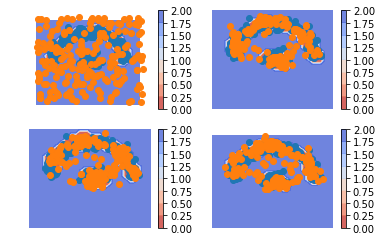

iteration  275
0.015215576 0.0031227125 0.80954957 -0.7974567


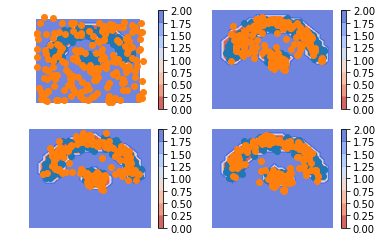

iteration  276
-0.012845933 0.0040808953 0.80131435 -0.8182412


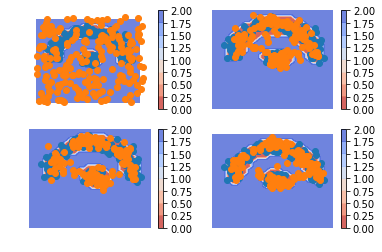

iteration  277
0.05091226 0.0049502254 0.83270425 -0.7867422


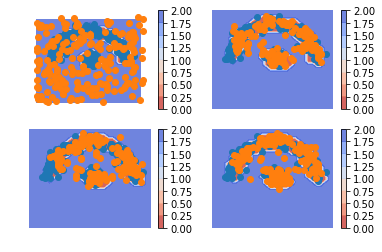

iteration  278
-0.04691595 0.006304547 0.784722 -0.8379425


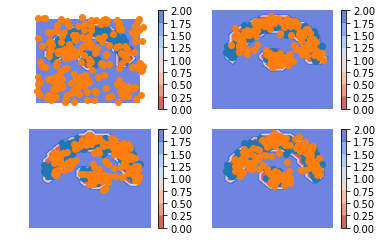

iteration  279
-0.018879414 0.007973852 0.81585974 -0.842713


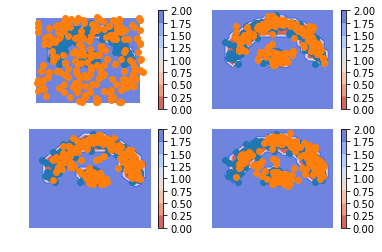

iteration  280
0.050899565 0.009358269 0.79068357 -0.7491423


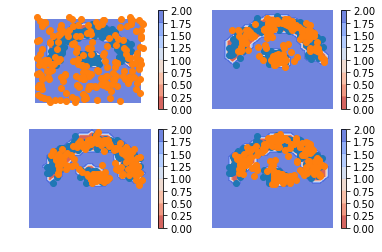

iteration  281
-0.028256297 0.010536868 0.7928064 -0.83159953


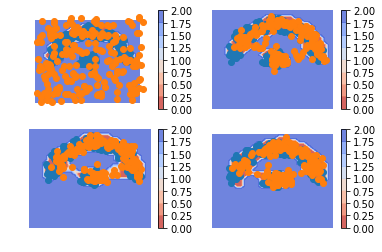

iteration  282
-0.052511215 0.012063567 0.78583837 -0.85041314


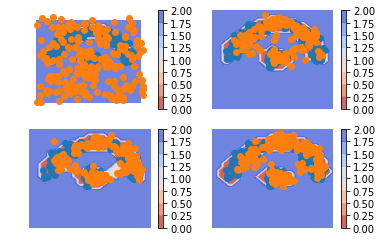

iteration  283
-0.020709217 0.0134452395 0.8027183 -0.83687276


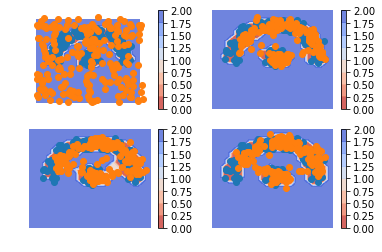

iteration  284
0.018407166 0.014309818 0.83139765 -0.8273003


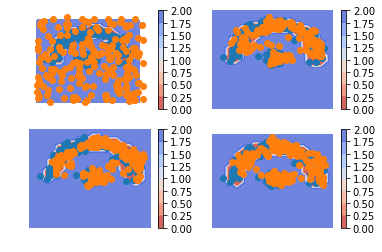

iteration  285
-0.036222875 0.013612061 0.8079293 -0.8577642


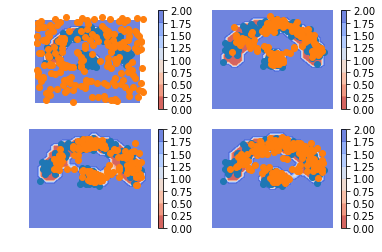

iteration  286
-0.033290446 0.012634919 0.8003764 -0.8463018


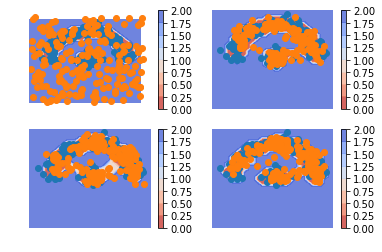

iteration  287
-0.04766506 0.011561279 0.81422675 -0.8734531


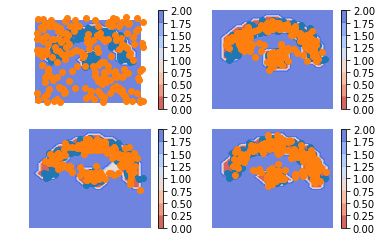

iteration  288
0.024163306 0.010752041 0.7773105 -0.7638992


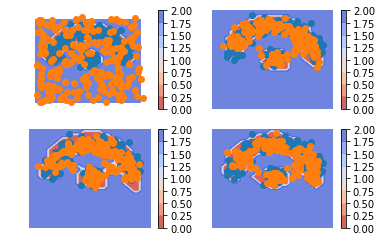

iteration  289
-0.059846103 0.009685556 0.7779536 -0.8474853


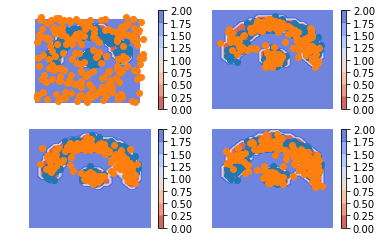

iteration  290
0.009939194 0.00804625 0.82745326 -0.82556033


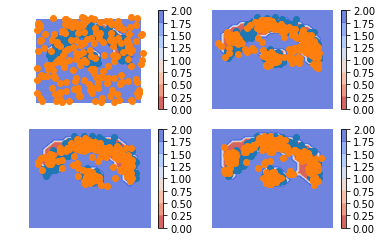

iteration  291
0.0843634 0.006370301 0.8308567 -0.7528636


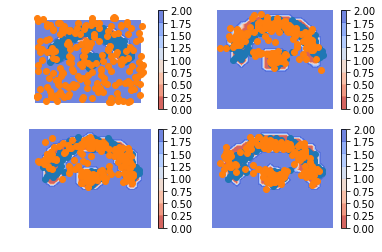

iteration  292
0.07310414 0.005078824 0.8091006 -0.74107534


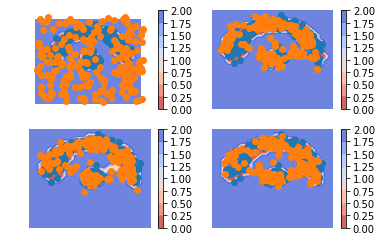

iteration  293
0.050786376 0.0041106814 0.80693626 -0.7602606


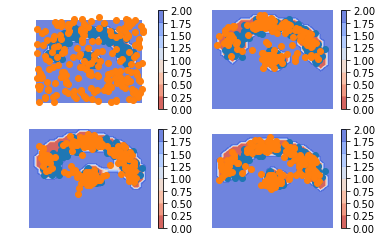

iteration  294
0.014460623 0.003206115 0.85038596 -0.8391315


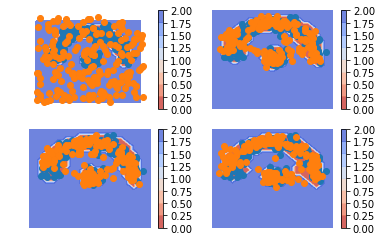

iteration  295
0.033557415 0.0028163737 0.81943065 -0.7886896


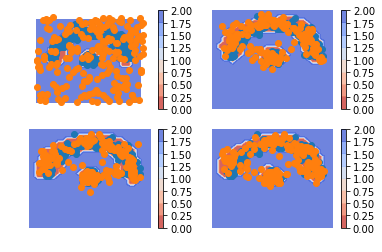

iteration  296
-0.0015884042 0.0029979395 0.81976295 -0.8243493


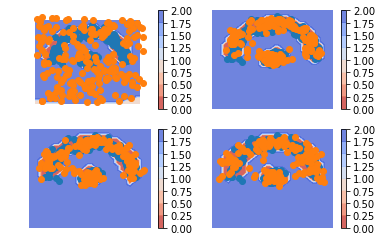

iteration  297
0.12713999 0.0034004108 0.80271447 -0.67897487


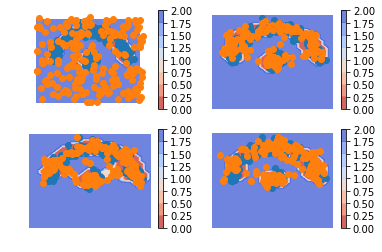

iteration  298
-0.04594952 0.003826414 0.7613215 -0.81109744


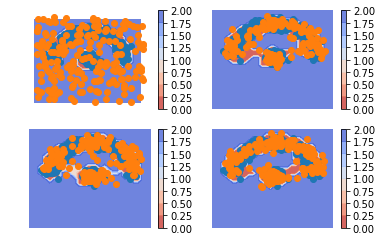

iteration  299
-0.13151318 0.0045241583 0.76916957 -0.9052069


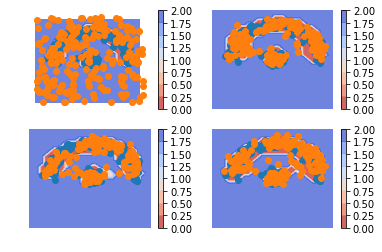

iteration  300
0.031813025 0.0057734284 0.84290063 -0.81686103


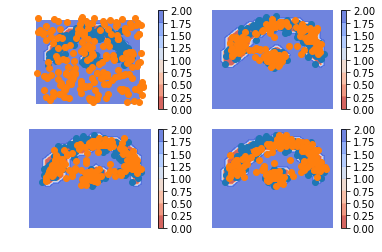

iteration  301
0.033085942 0.006509811 0.8002925 -0.7737164


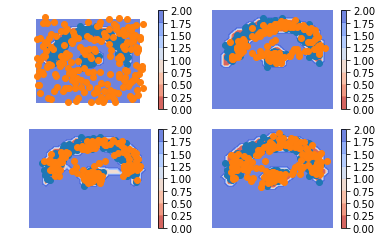

iteration  302
0.011495471 0.006764801 0.8048706 -0.80013996


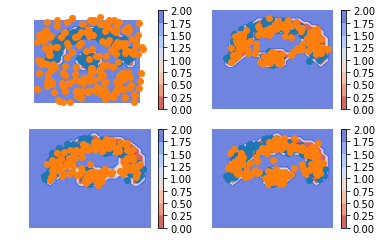

iteration  303
0.018759906 0.006962557 0.77678233 -0.76498497


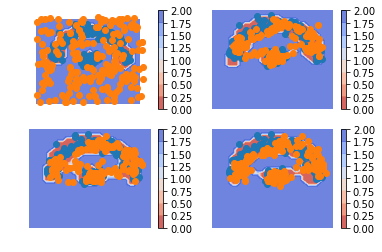

iteration  304
-0.061154783 0.00726487 0.80410457 -0.8725242


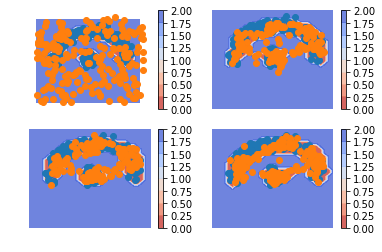

iteration  305
0.0074552894 0.0074758483 0.79614425 -0.7961648


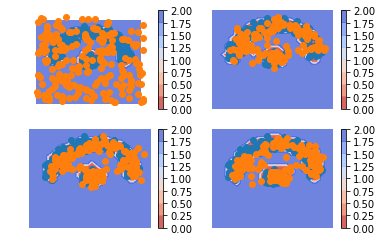

iteration  306
0.009819448 0.007924985 0.79487586 -0.7929814


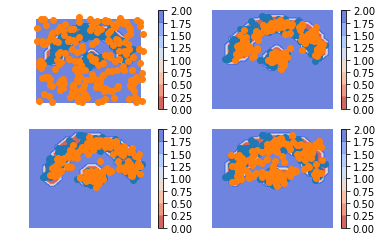

iteration  307
-0.070118785 0.008214692 0.7925916 -0.87092507


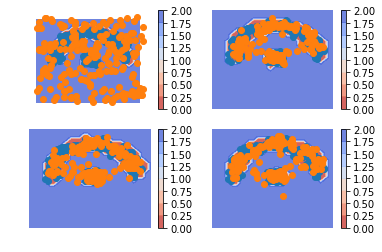

iteration  308
-0.029406607 0.009349227 0.7925758 -0.8313316


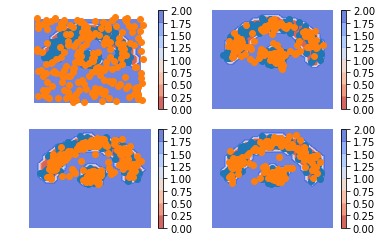

iteration  309
-0.030027926 0.010238096 0.8180378 -0.85830384


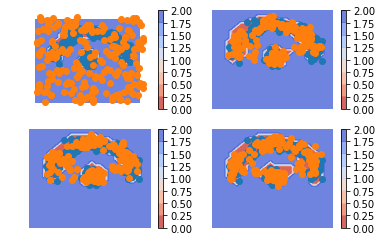

iteration  310
0.058660865 0.011741733 0.8541844 -0.8072653


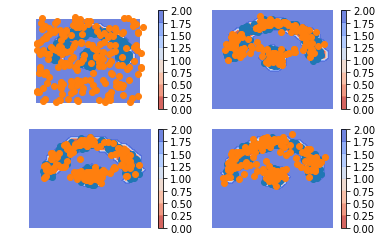

iteration  311
0.17192525 0.0135240145 0.8320316 -0.67363036


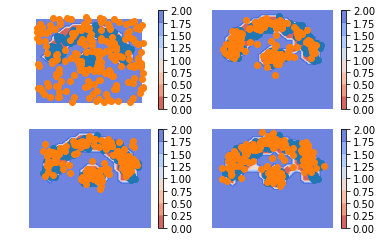

iteration  312
0.018679678 0.015090828 0.8305854 -0.82699656


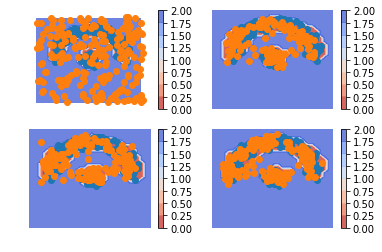

iteration  313
-0.020252645 0.015964398 0.8101711 -0.84638816


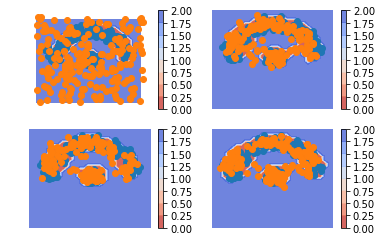

iteration  314
-0.010254025 0.01635995 0.7825861 -0.80920005


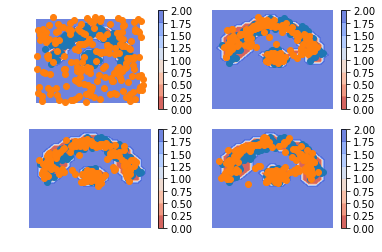

iteration  315
0.0154700875 0.016171604 0.784252 -0.78495353


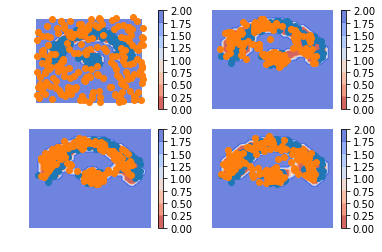

iteration  316
-0.012764156 0.015899964 0.75300336 -0.7816675


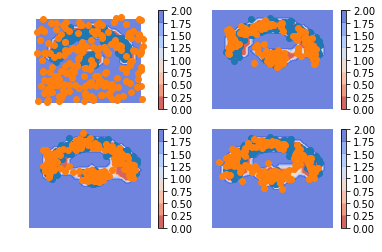

iteration  317
-0.0052888393 0.015629925 0.7838014 -0.80472016


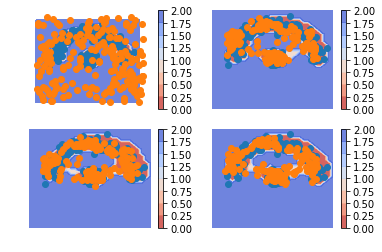

iteration  318
0.052944064 0.014179189 0.8037602 -0.7649953


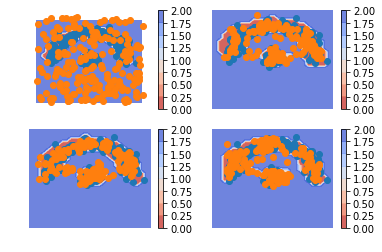

iteration  319
-0.0060877204 0.012224579 0.81826305 -0.8365753


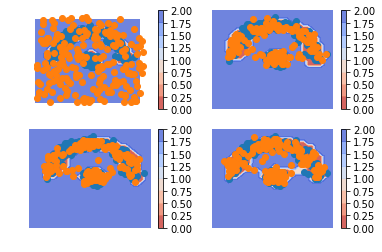

iteration  320
-0.007647872 0.010219523 0.7939185 -0.8117859


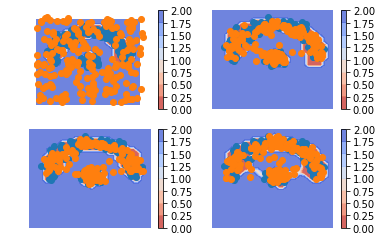

iteration  321
-0.0146766305 0.008822155 0.7850879 -0.80858666


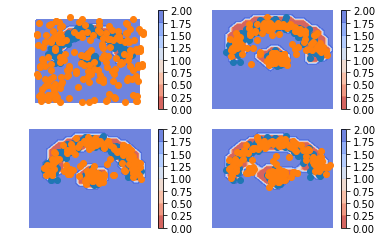

iteration  322
0.0135291815 0.007496284 0.81529164 -0.80925876


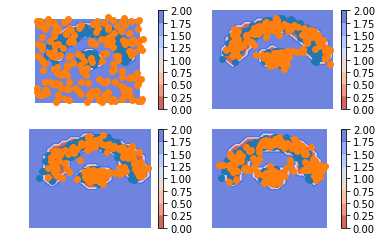

iteration  323
0.026679516 0.006644792 0.8301774 -0.8101427


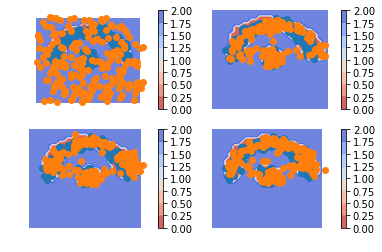

iteration  324
0.03056097 0.006048559 0.83719826 -0.81268585


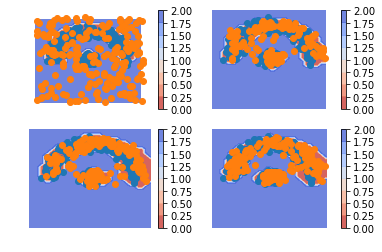

iteration  325
-0.024578929 0.0056325626 0.81962293 -0.84983444


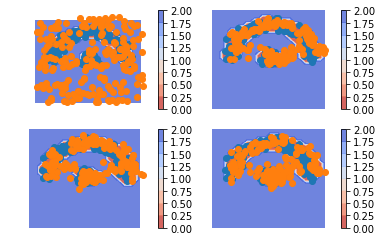

iteration  326
0.030663252 0.004935044 0.8247622 -0.799034


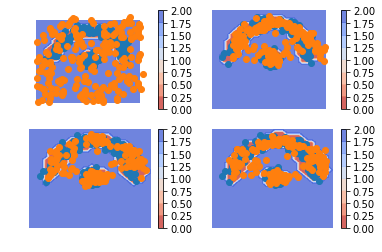

iteration  327
-0.036744595 0.0044489256 0.7820774 -0.8232709


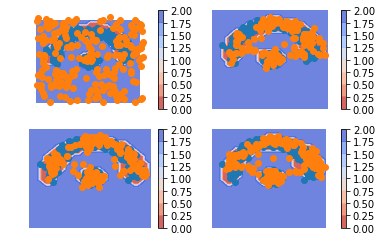

iteration  328
-0.06292981 0.00422147 0.79915 -0.8663013


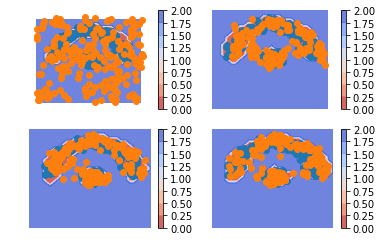

iteration  329
-0.0817768 0.0039577037 0.7715881 -0.8573226


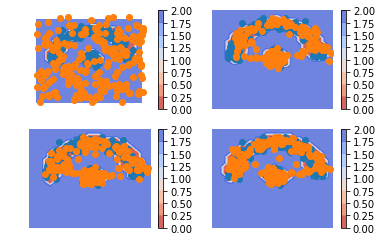

iteration  330
-0.028258622 0.0039419318 0.7900358 -0.82223636


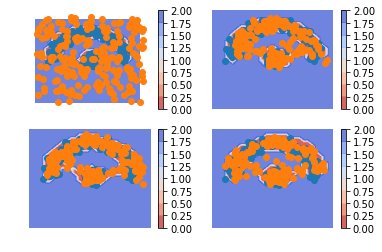

iteration  331
-0.043132603 0.004027262 0.8228954 -0.87005526


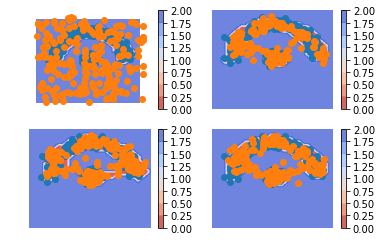

iteration  332
0.007847428 0.004062194 0.790378 -0.7865927


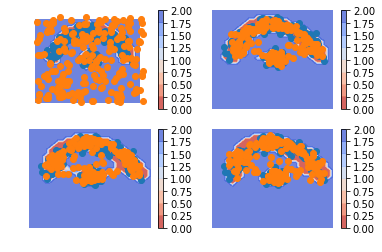

iteration  333
-0.02569437 0.004312743 0.8060736 -0.83608073


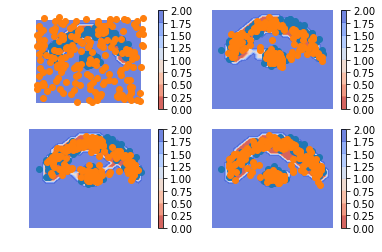

iteration  334
-0.0013153553 0.004369224 0.83131415 -0.8369987


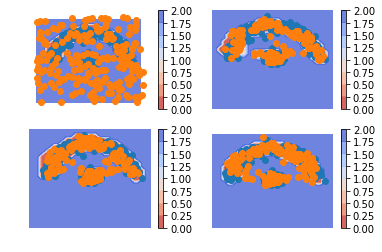

iteration  335
0.015403032 0.0043628407 0.81582975 -0.80478954


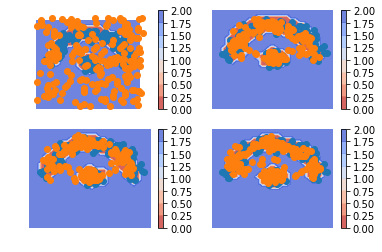

iteration  336
-0.04974103 0.0048964177 0.7791616 -0.833799


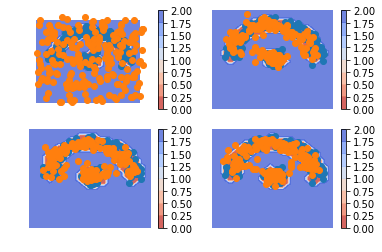

iteration  337
-0.008712769 0.0052712006 0.77871 -0.792694


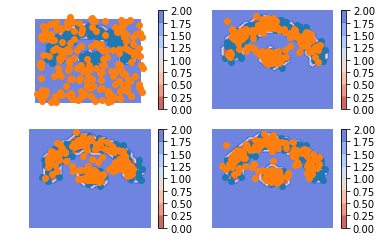

iteration  338
-0.014088988 0.0053696837 0.80542874 -0.8248874


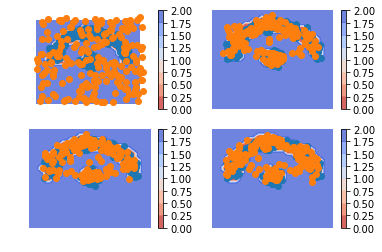

iteration  339
0.04565394 0.0049584396 0.77700424 -0.73630875


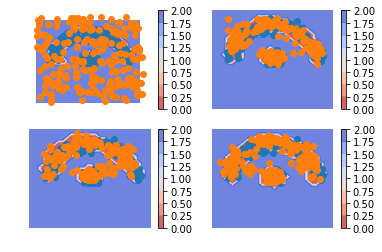

iteration  340
-0.042330623 0.005067612 0.8067685 -0.8541667


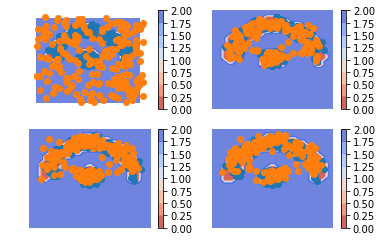

iteration  341
0.0064591765 0.0054120626 0.8211715 -0.8201244


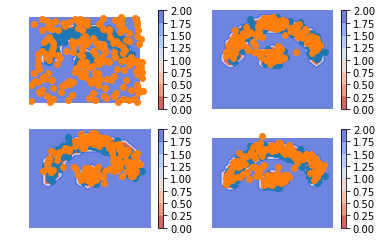

iteration  342
0.0046524405 0.0062515666 0.83060503 -0.83220416


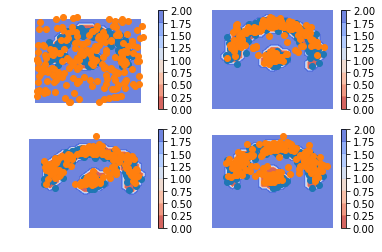

iteration  343
-0.021811903 0.006366248 0.7842532 -0.81243134


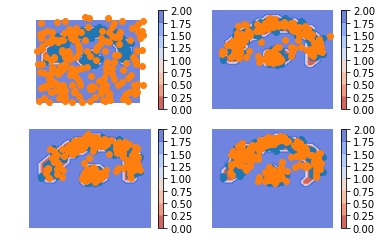

iteration  344
0.03707248 0.0062081353 0.84253407 -0.8116697


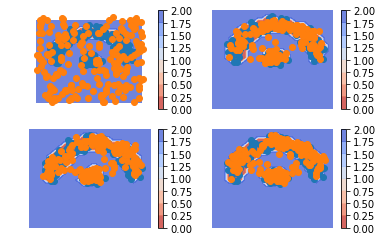

iteration  345
-0.016836226 0.0062755495 0.78938115 -0.8124929


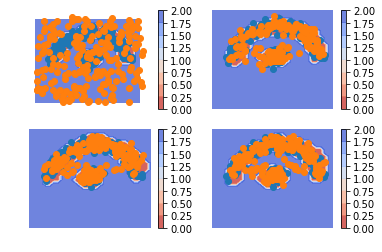

iteration  346
-0.030334651 0.0064532445 0.8117348 -0.84852266


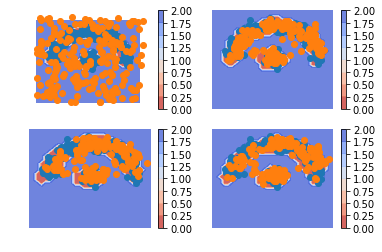

iteration  347
-0.020784676 0.0067771333 0.8091012 -0.836663


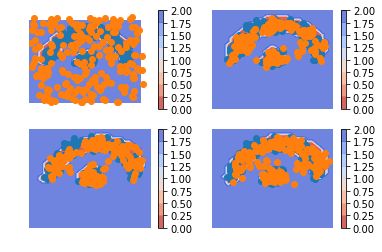

iteration  348
0.021739125 0.007522072 0.82041365 -0.8061966


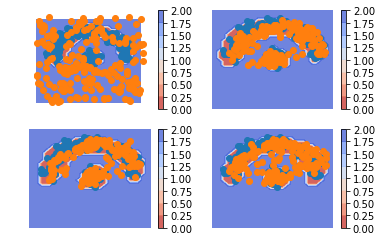

iteration  349
-0.032291472 0.008395652 0.8078724 -0.84855956


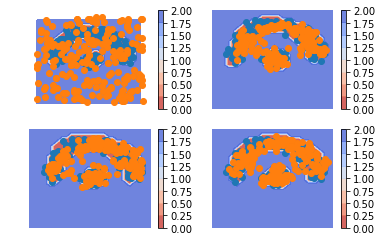

iteration  350
-0.03618139 0.009043243 0.7863035 -0.8315281


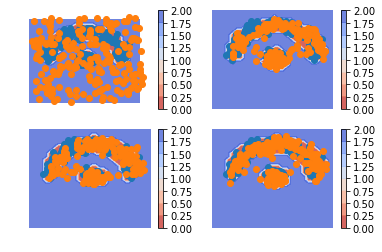

iteration  351
0.0070818663 0.009958792 0.8334643 -0.83634126


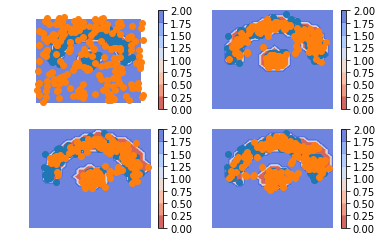

iteration  352
0.0013321638 0.010687692 0.85151744 -0.860873


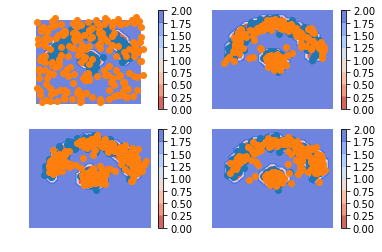

iteration  353
-0.037409365 0.011212407 0.803633 -0.85225475


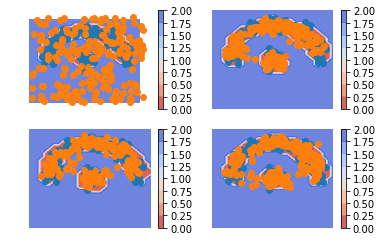

iteration  354
0.002571702 0.011453882 0.8358389 -0.8447211


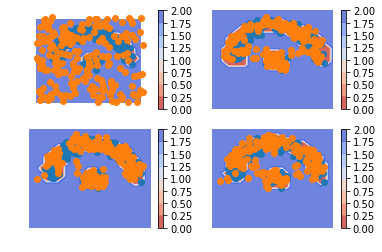

iteration  355
0.017019093 0.010683302 0.798931 -0.7925952


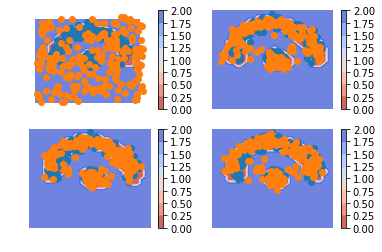

iteration  356
-0.053771555 0.009649122 0.77334934 -0.83677


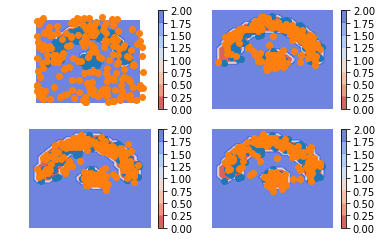

iteration  357
0.112032235 0.008205042 0.83956075 -0.73573357


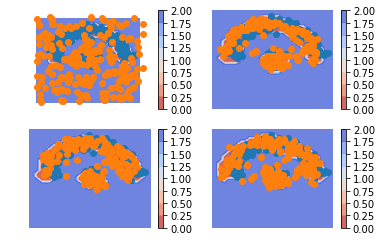

iteration  358
-0.0112653375 0.0072283205 0.7976146 -0.8161082


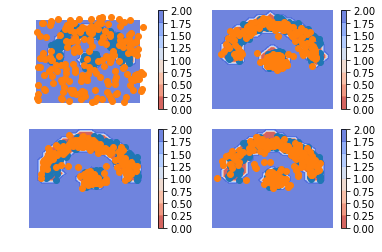

iteration  359
-0.06940627 0.0061262734 0.7945297 -0.87006223


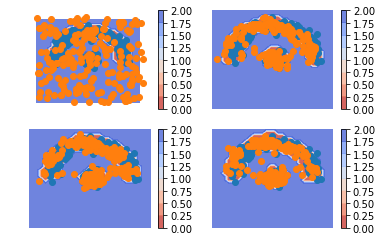

iteration  360
-0.0450083 0.00543093 0.7814776 -0.8319168


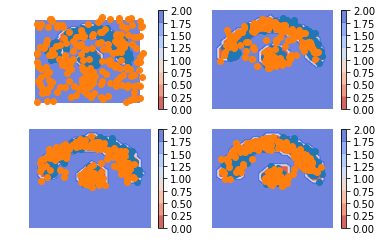

iteration  361
-0.026789665 0.004917172 0.8192427 -0.8509495


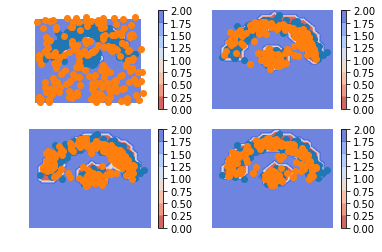

iteration  362
-0.022215426 0.0044380496 0.8353603 -0.86201376


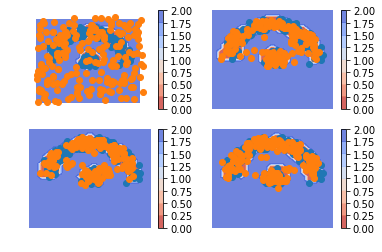

iteration  363
-0.04371673 0.0037690958 0.80214405 -0.8496299


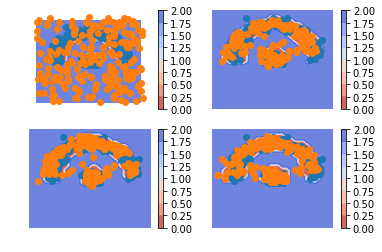

iteration  364
-0.026440501 0.0031641359 0.81217647 -0.8417811


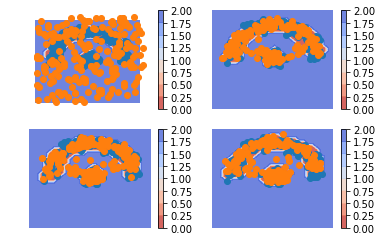

iteration  365
-0.079830885 0.0030320939 0.80205464 -0.8849176


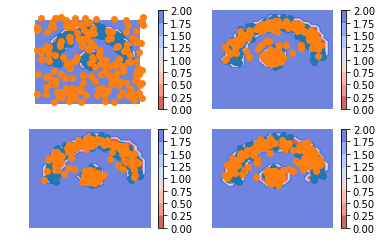

iteration  366
0.014990628 0.0033142073 0.8337938 -0.8221174


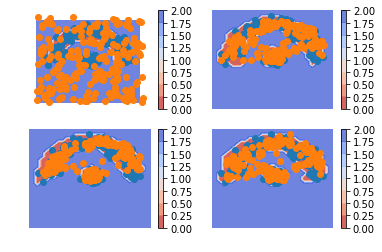

iteration  367
-0.10198724 0.0040264623 0.81941396 -0.9254277


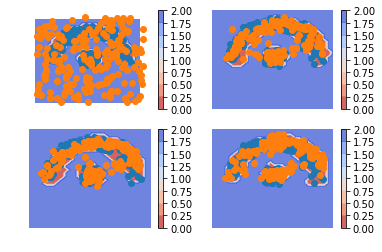

iteration  368
-0.031000555 0.005014735 0.8261193 -0.8621346


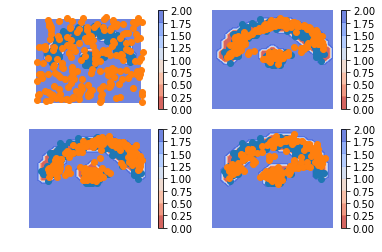

iteration  369
0.0669536 0.0061326423 0.8569924 -0.7961715


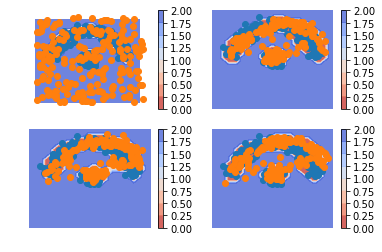

iteration  370
0.012249231 0.0076039727 0.7758838 -0.7712385


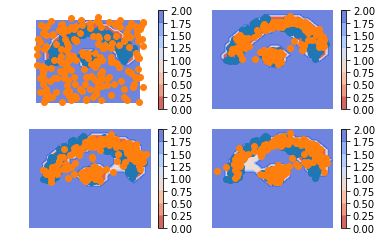

iteration  371
-0.035478294 0.00840915 0.794762 -0.83864945


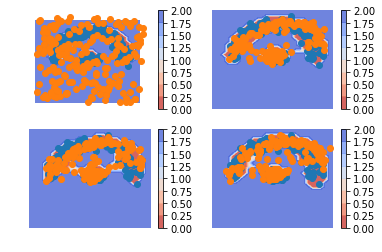

iteration  372
0.012431204 0.0084819775 0.8453616 -0.84141237


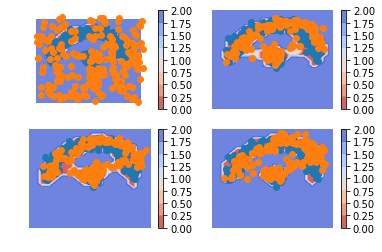

iteration  373
-0.0054499507 0.008258379 0.79481864 -0.808527


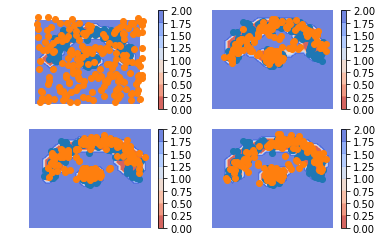

iteration  374
-0.044464648 0.007398854 0.80262756 -0.85449106


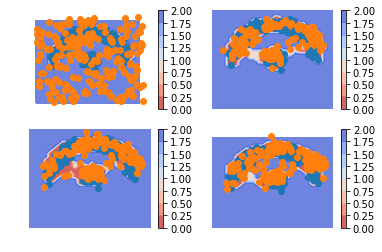

iteration  375
-0.018897772 0.0061879586 0.8070892 -0.83217496


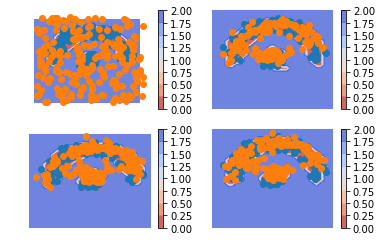

iteration  376
-0.13526434 0.005257128 0.7997284 -0.94024986


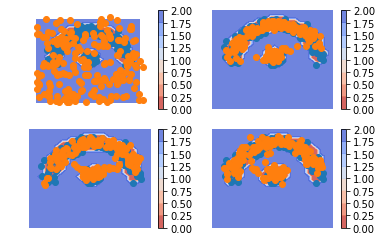

iteration  377
-0.064311504 0.004720998 0.7984167 -0.86744916


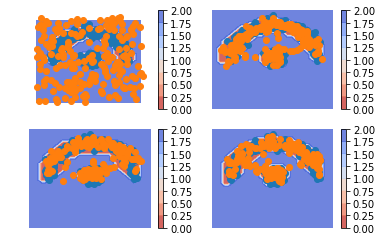

iteration  378
0.011815369 0.0045102555 0.82067597 -0.8133709


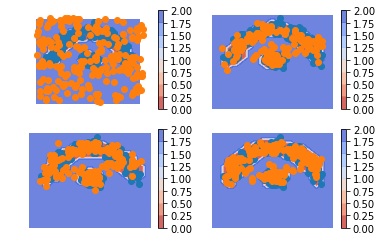

iteration  379
-0.037922084 0.0043820324 0.80538094 -0.84768504


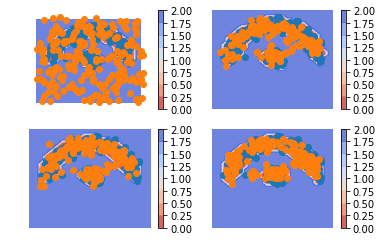

iteration  380
-0.05948937 0.004380757 0.76540333 -0.82927346


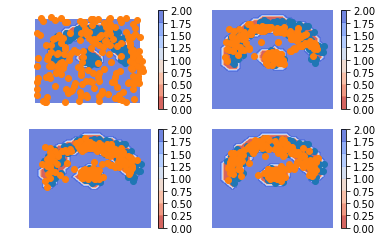

iteration  381
0.00180161 0.004441237 0.8017709 -0.8044106


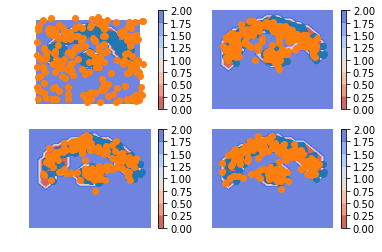

iteration  382
0.0048791766 0.0047497004 0.7929456 -0.79281616


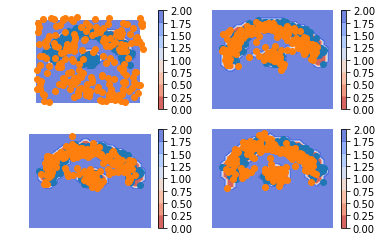

iteration  383
0.047367513 0.004983109 0.7808237 -0.7384393


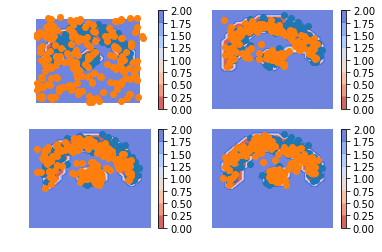

iteration  384
-0.08273518 0.0051138685 0.7845463 -0.87239534


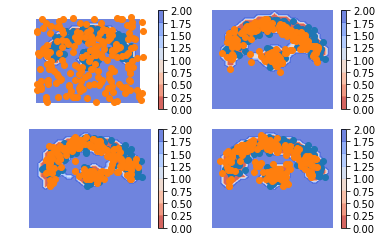

iteration  385
-0.050863147 0.005155396 0.7746088 -0.8306273


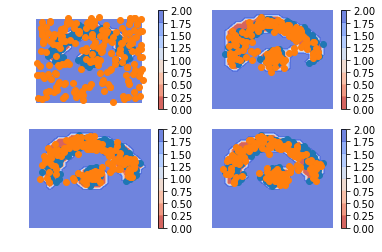

iteration  386
-0.024003208 0.0057376963 0.77058256 -0.8003235


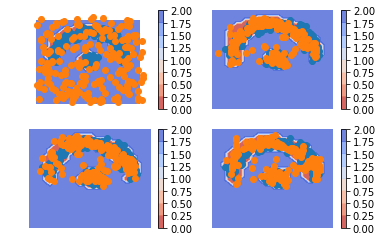

iteration  387
0.031347156 0.0058001913 0.80404675 -0.7784998


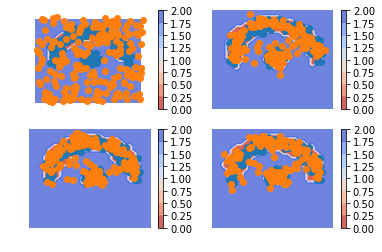

iteration  388
0.03479153 0.006089496 0.79580384 -0.7671018


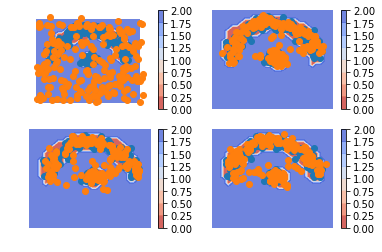

iteration  389
0.037584007 0.0060463436 0.8032981 -0.77176046


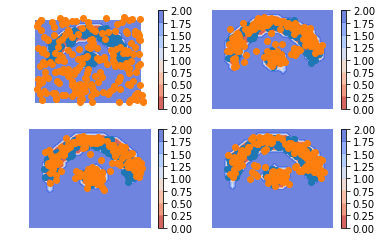

iteration  390
0.01572901 0.006107332 0.7783654 -0.7687437


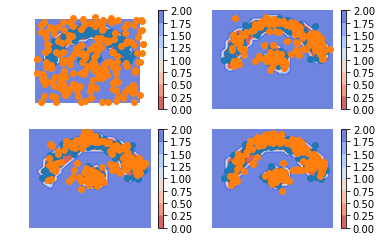

iteration  391
-0.026456296 0.006150694 0.7894525 -0.8220595


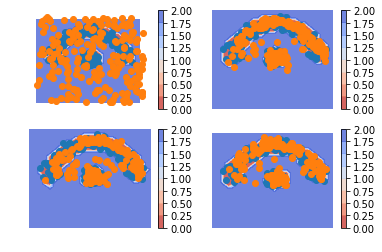

iteration  392
0.017310679 0.0062371907 0.7901083 -0.77903485


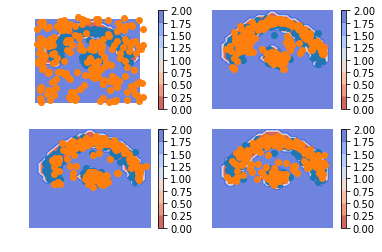

iteration  393
-0.033712924 0.0064936755 0.8270098 -0.8672164


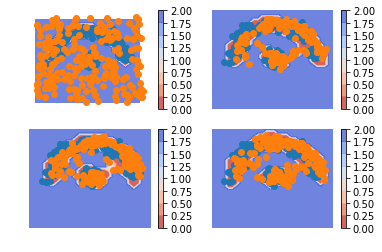

iteration  394
-0.024683774 0.0069874907 0.78669244 -0.8183637


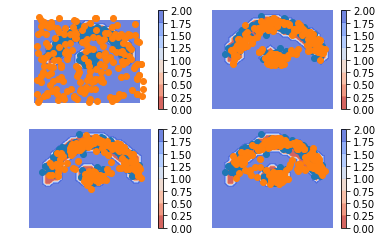

iteration  395
-0.03700435 0.007408133 0.80668163 -0.8510941


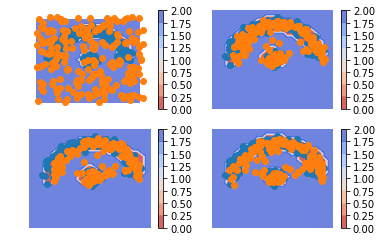

iteration  396
-0.023395121 0.00786355 0.7907629 -0.82202154


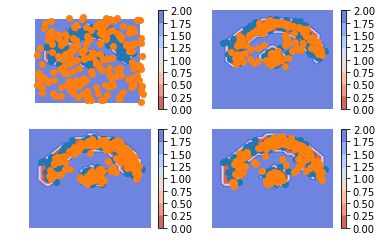

iteration  397
-0.047398746 0.008599296 0.78890824 -0.8449063


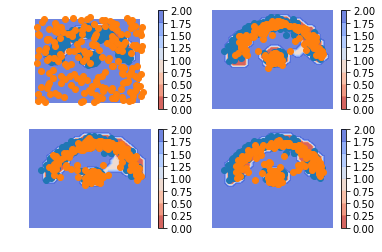

iteration  398
-0.013221979 0.009231788 0.78863704 -0.8110908


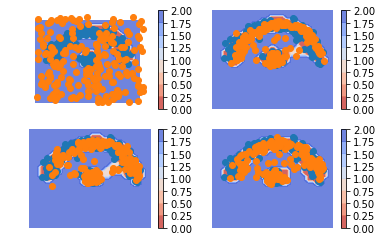

iteration  399
-0.033022046 0.009101818 0.8146713 -0.85679513


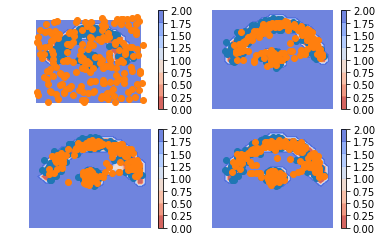

iteration  400
-0.011544526 0.008989834 0.78430474 -0.8048391


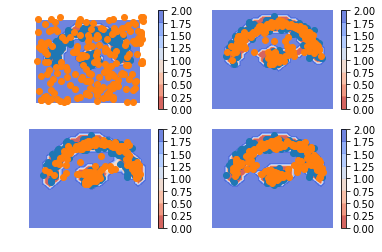

iteration  401
-0.028777182 0.00824927 0.804725 -0.84175146


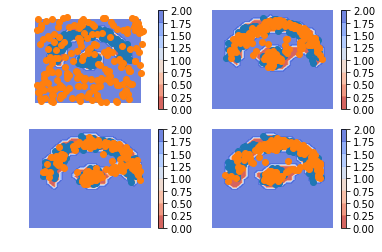

iteration  402
-0.0715965 0.0074697663 0.79553527 -0.87460154


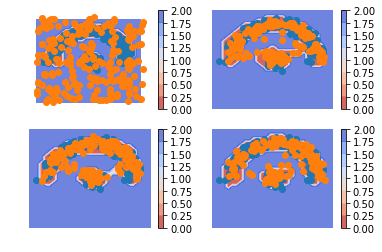

iteration  403
-0.05494976 0.0061539207 0.7634849 -0.8245886


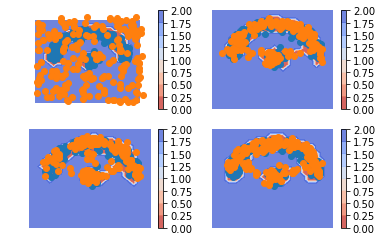

iteration  404
-0.036575317 0.00532545 0.7749867 -0.81688744


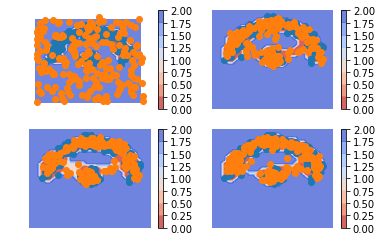

iteration  405
-0.03181964 0.0050064316 0.8283421 -0.86516815


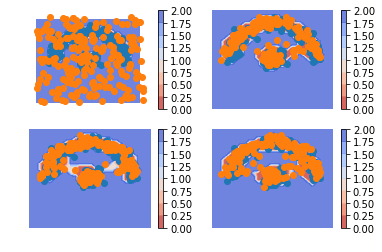

iteration  406
-0.014423132 0.0049338 0.8063196 -0.8256765


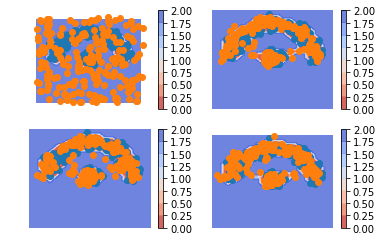

iteration  407
-0.03423184 0.004977045 0.8165338 -0.8557427


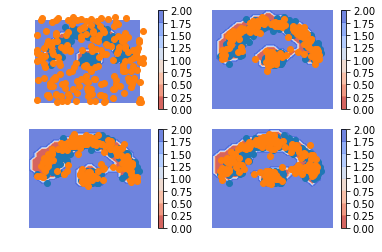

iteration  408
-0.048761606 0.0048998753 0.8240723 -0.87773377


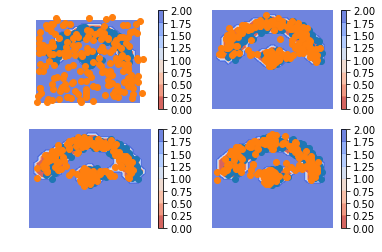

iteration  409
-0.037382185 0.0048427377 0.8037878 -0.8460128


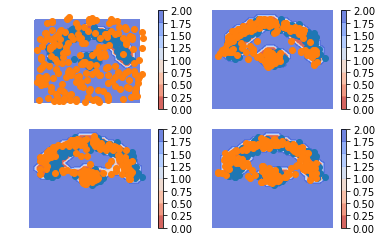

iteration  410
-0.01689595 0.004824255 0.81151015 -0.8332304


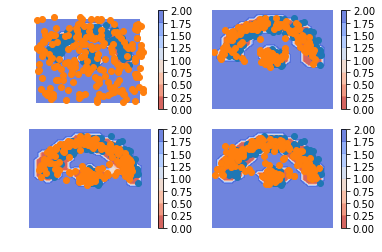

iteration  411
-0.017596722 0.004727194 0.8303784 -0.8527023


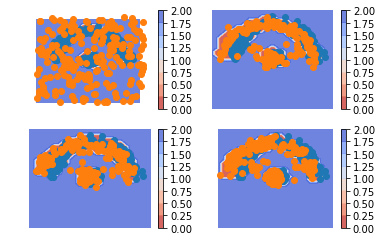

iteration  412
-0.0259161 0.0049409843 0.82793105 -0.85878813


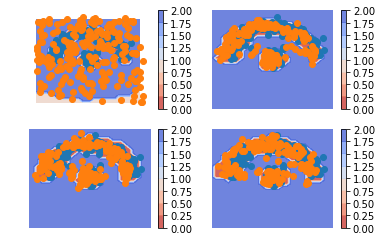

iteration  413
0.13630122 0.0049758703 0.7877023 -0.65637696


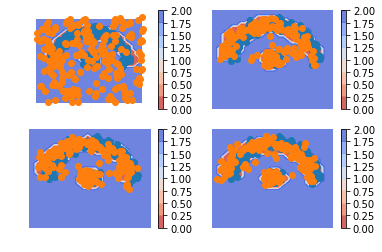

iteration  414
0.015394628 0.004792068 0.7900261 -0.7794236


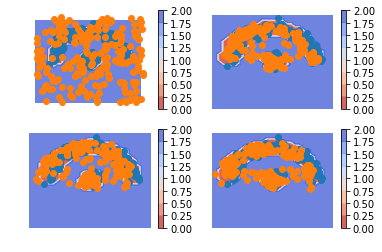

iteration  415
0.044424176 0.0044335057 0.7962068 -0.7562161


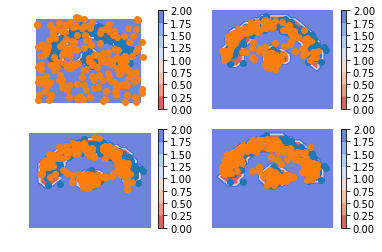

iteration  416
0.0026971698 0.00419354 0.78034884 -0.7818452


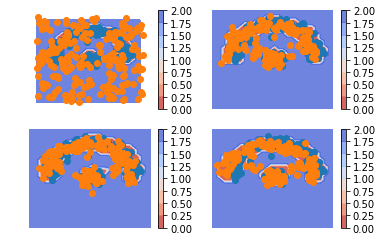

iteration  417
0.05407685 0.0040707313 0.8162489 -0.7662428


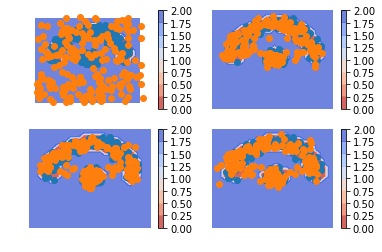

iteration  418
-0.011911333 0.0043153903 0.81588 -0.8321067


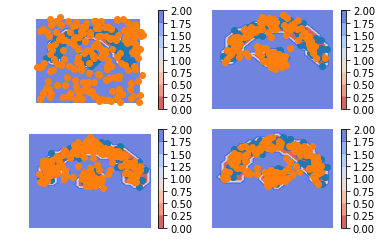

iteration  419
-0.06084317 0.005046724 0.7992018 -0.8650917


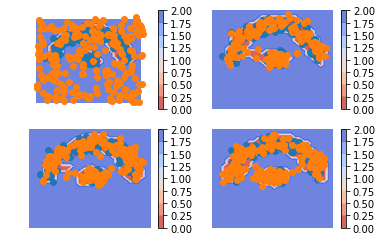

iteration  420
0.04001069 0.0060590394 0.84053284 -0.8065812


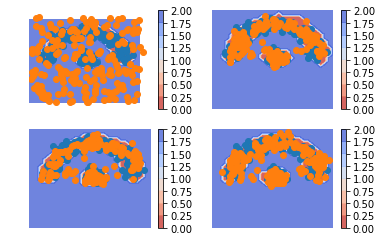

iteration  421
-0.060153067 0.0068966467 0.7986702 -0.8657199


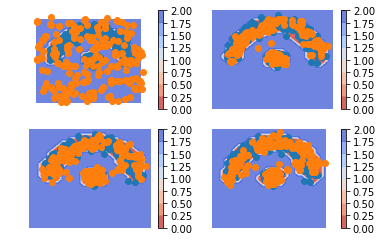

iteration  422
0.012809813 0.0072434274 0.8390292 -0.83346283


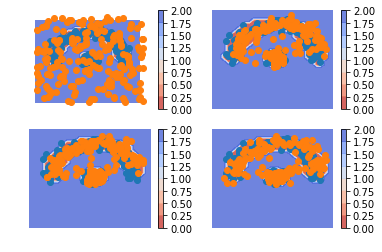

iteration  423
0.06402069 0.0073321015 0.8204658 -0.7637772


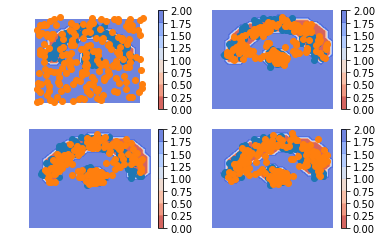

iteration  424
0.008775294 0.007105429 0.8207997 -0.8191298


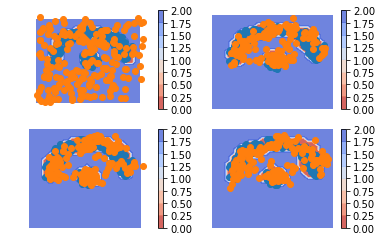

iteration  425
0.009224117 0.006624492 0.7949092 -0.7923096


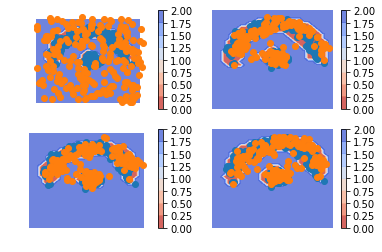

iteration  426
-0.0076655746 0.005835732 0.8251438 -0.8386451


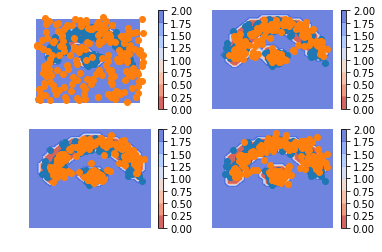

iteration  427
0.005483806 0.0050293542 0.8290758 -0.8286214


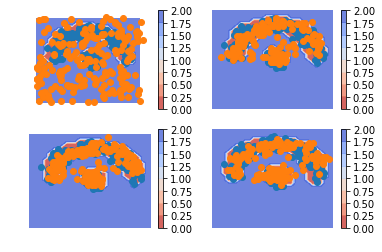

iteration  428
-0.0052167177 0.004468681 0.81458557 -0.82427096


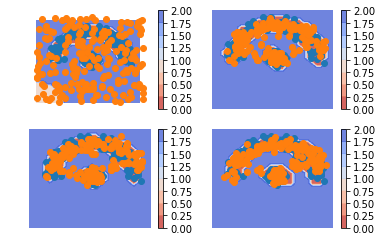

iteration  429
0.24186832 0.0043249405 0.7918149 -0.5542715


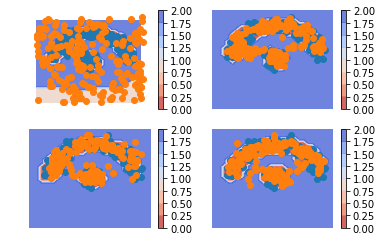

iteration  430
0.088994205 0.003990493 0.7876106 -0.70260686


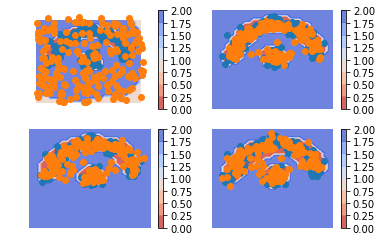

iteration  431
0.07364315 0.0039348803 0.8266969 -0.7569886


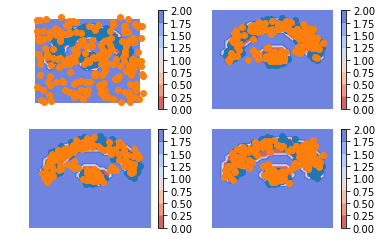

iteration  432
-0.03360492 0.003645622 0.8006136 -0.8378641


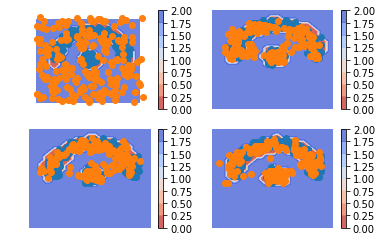

iteration  433
-0.05191976 0.0035643813 0.8152273 -0.87071145


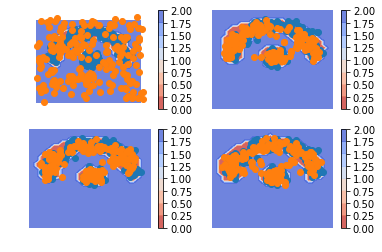

iteration  434
-0.015428066 0.0030725943 0.800722 -0.8192227


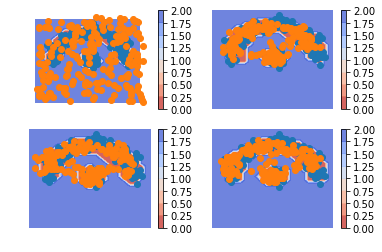

iteration  435
-0.06034714 0.0023872796 0.7908247 -0.85355914


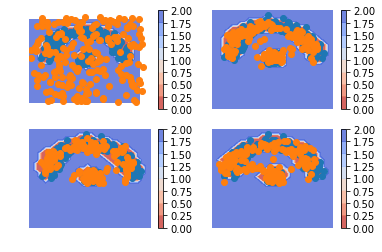

iteration  436
-0.05388421 0.0017851281 0.832177 -0.8878463


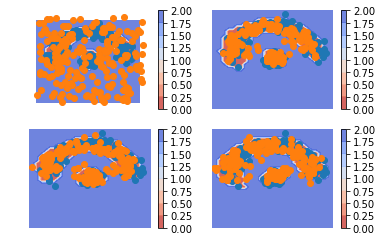

iteration  437
-0.017824292 0.0015403144 0.80153096 -0.82089555


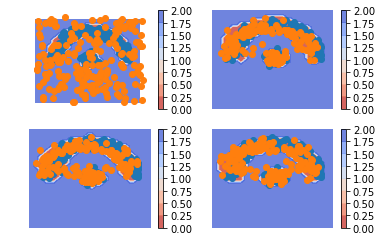

iteration  438
-0.09169227 0.001560281 0.76024497 -0.8534975


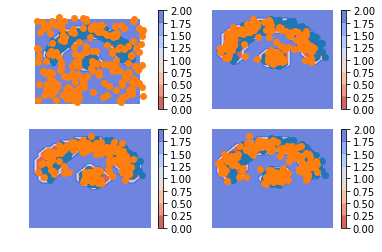

iteration  439
0.0072587132 0.0016635874 0.83458054 -0.8289854


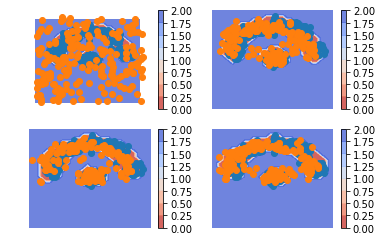

iteration  440
-0.059307575 0.002213266 0.80115557 -0.8626764


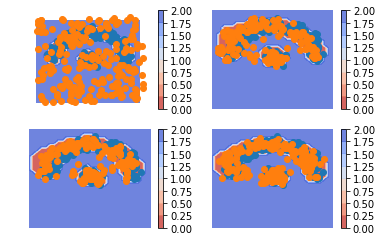

iteration  441
-0.044415414 0.003102341 0.8369008 -0.88441855


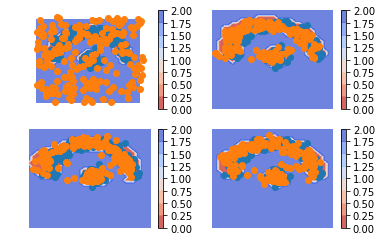

iteration  442
0.044255912 0.0042047426 0.80665636 -0.7666052


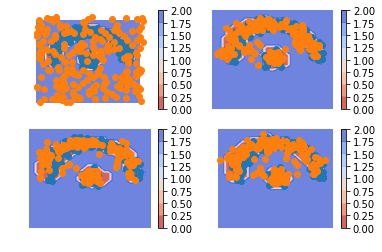

iteration  443
0.003068328 0.005640366 0.80518997 -0.807762


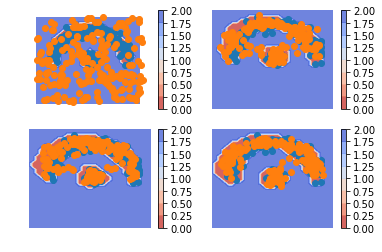

iteration  444
-0.016227663 0.0066157132 0.8373684 -0.8602118


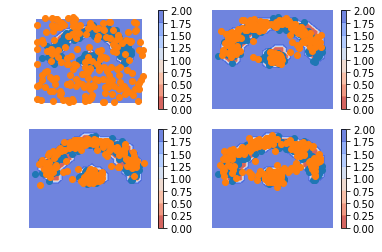

iteration  445
0.016059756 0.007991906 0.7773617 -0.76929384


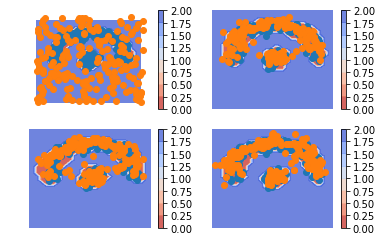

iteration  446
-0.021592557 0.008880952 0.840122 -0.8705955


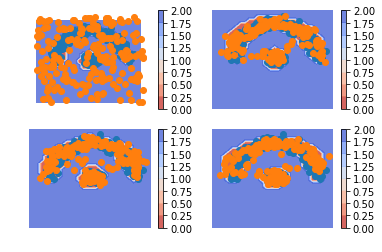

iteration  447
-0.04888624 0.009231412 0.8152497 -0.8733673


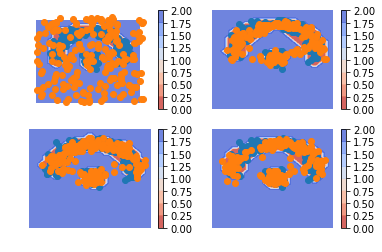

iteration  448
-0.10361153 0.009028453 0.7912836 -0.9039236


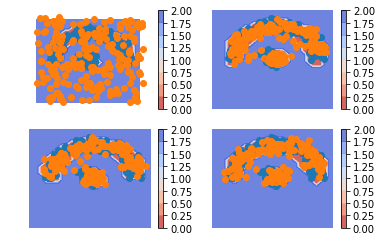

iteration  449
-0.0014457107 0.009403482 0.78116214 -0.7920113


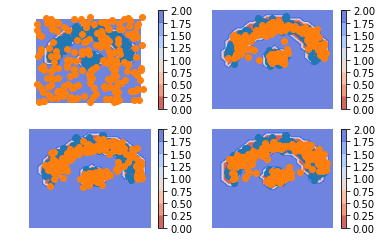

iteration  450
0.0023647547 0.009234392 0.8409748 -0.8478444


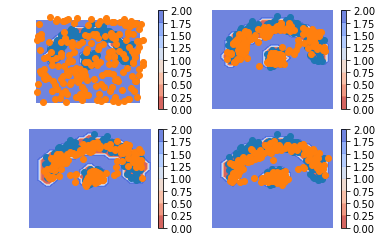

iteration  451
-0.009772241 0.009328306 0.79136944 -0.81047


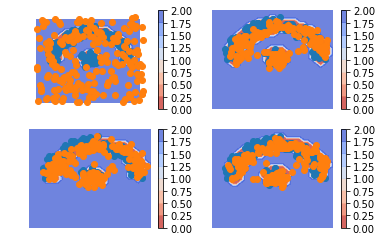

iteration  452
-0.08338487 0.009122309 0.75380814 -0.8463153


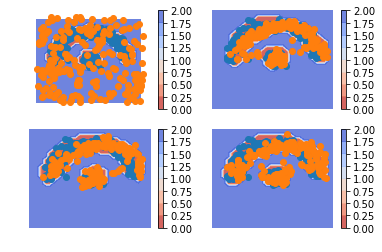

iteration  453
-0.10979223 0.008289855 0.7782409 -0.896323


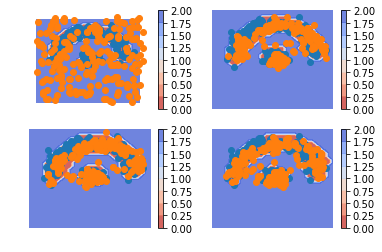

iteration  454
-0.020016074 0.0077454 0.8081026 -0.83586407


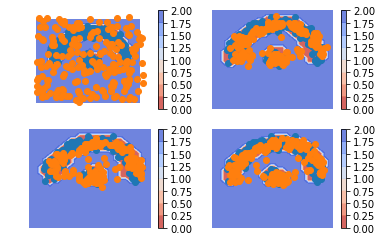

iteration  455
-0.09234375 0.0072858864 0.77916825 -0.8787979


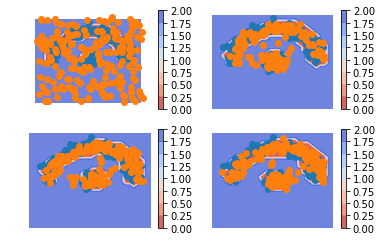

iteration  456
-0.060901582 0.007216268 0.8165803 -0.88469815


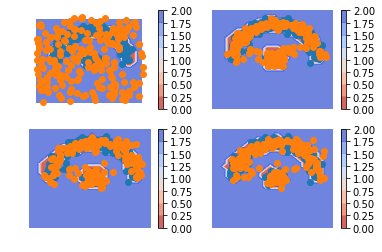

iteration  457
0.019278526 0.0075661596 0.813785 -0.80207264


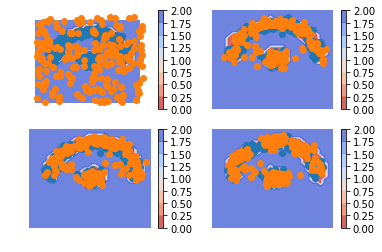

iteration  458
-0.07245362 0.007558393 0.8092427 -0.88925475


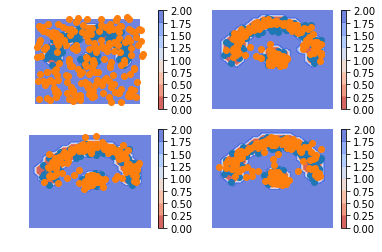

iteration  459
0.045902252 0.007502034 0.85950184 -0.8211016


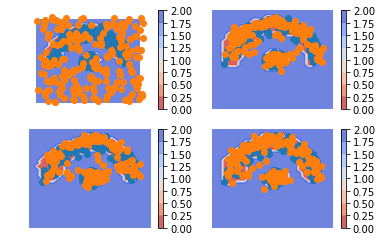

iteration  460
-0.002659738 0.007241447 0.8127935 -0.82269466


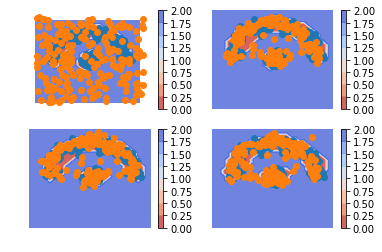

iteration  461
-0.07291007 0.0067394525 0.80292356 -0.88257307


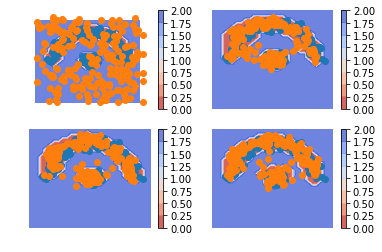

iteration  462
-0.058051288 0.00625848 0.7970008 -0.8613106


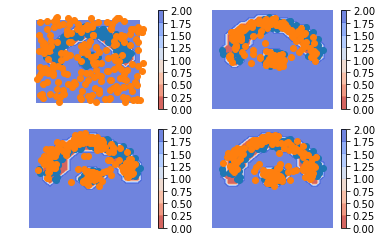

iteration  463
-0.045065343 0.0055903764 0.8097762 -0.8604319


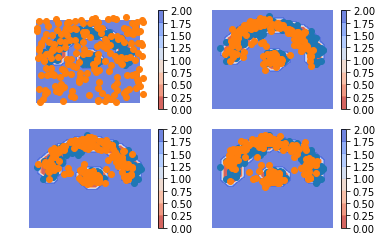

iteration  464
-0.0677191 0.0050244937 0.78893363 -0.8616772


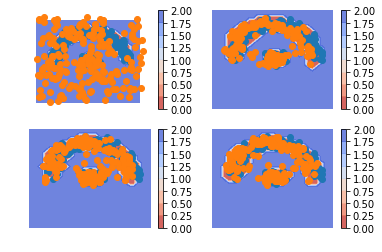

iteration  465
0.06328541 0.004551941 0.81802505 -0.7592916


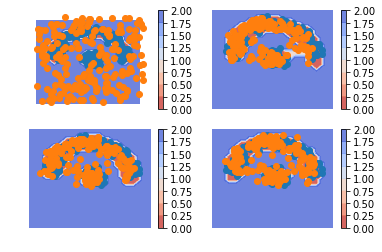

iteration  466
-0.020840406 0.003963472 0.8173733 -0.84217715


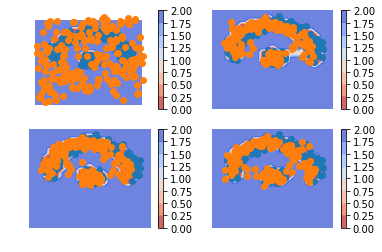

iteration  467
-0.051461756 0.003511283 0.8010862 -0.85605925


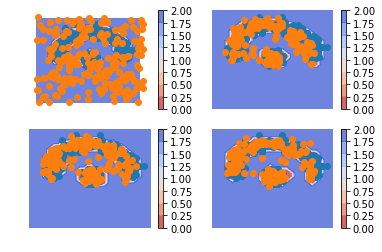

iteration  468
-0.08576548 0.0030204263 0.7992598 -0.88804567


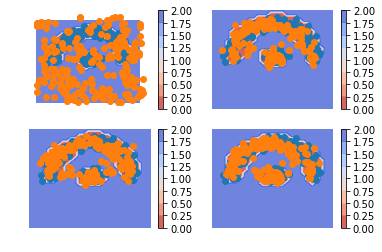

iteration  469
-0.103592396 0.002630161 0.77175677 -0.87797934


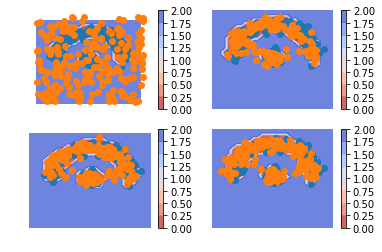

iteration  470
-0.072535574 0.0024313529 0.7789912 -0.85395813


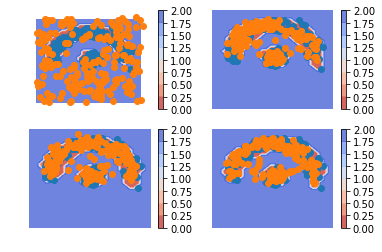

iteration  471
-0.08828312 0.0023665489 0.8222133 -0.91286296


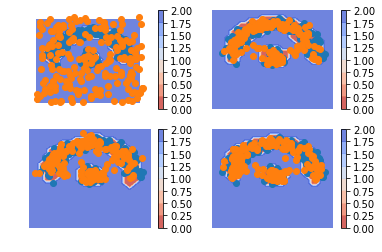

iteration  472
-0.03527075 0.0023545073 0.8091339 -0.84675914


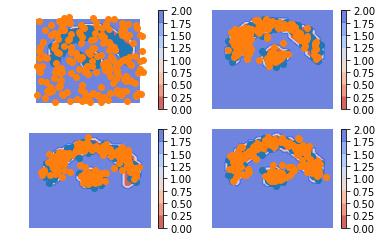

iteration  473
-0.05505544 0.0025176676 0.79475665 -0.85232973


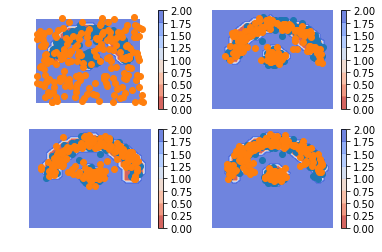

iteration  474
-0.0030346513 0.0025698007 0.80476874 -0.8103732


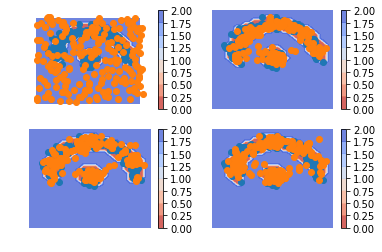

iteration  475
-0.024581194 0.0026496418 0.8336511 -0.860882


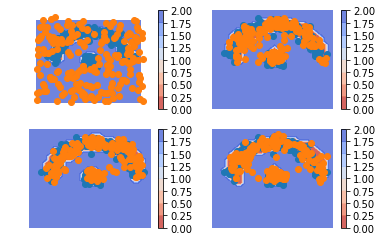

iteration  476
0.018274784 0.0026274172 0.79819465 -0.7825473


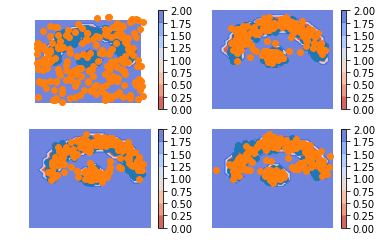

iteration  477
-0.013155401 0.0027811897 0.80451095 -0.82044756


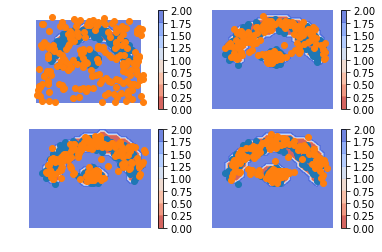

iteration  478
-0.035289586 0.0028274118 0.78713703 -0.825254


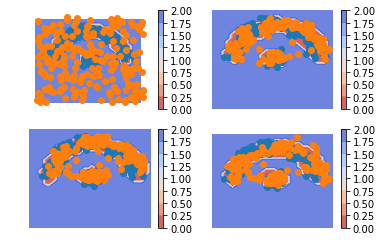

iteration  479
-0.04253429 0.0025732422 0.785362 -0.83046955


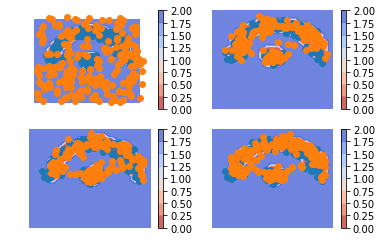

iteration  480
-0.050244093 0.0022434855 0.79955846 -0.852046


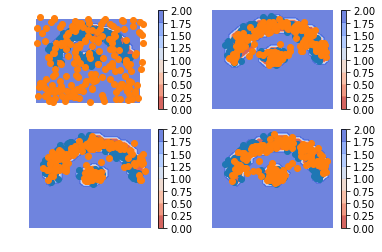

iteration  481
0.005797684 0.0020593859 0.83296895 -0.82923067


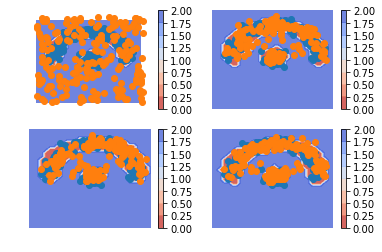

iteration  482
-0.034234226 0.0019171592 0.80140543 -0.83755684


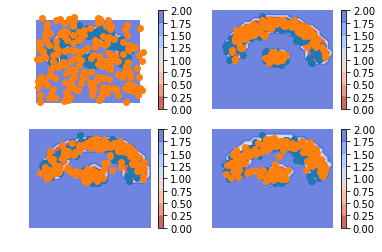

iteration  483
0.12339866 0.0019671293 0.7838492 -0.66241765


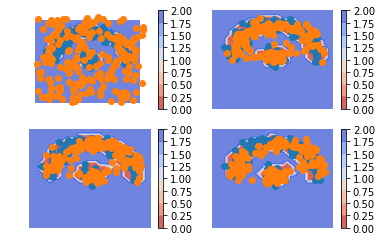

iteration  484
-0.0056934357 0.0020560292 0.7975784 -0.80532783


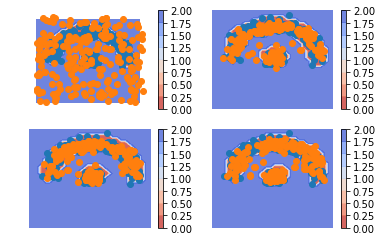

iteration  485
-0.06483835 0.0023270242 0.77310723 -0.8402726


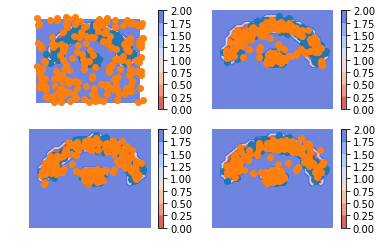

iteration  486
-0.04449606 0.0027064674 0.80600834 -0.85321087


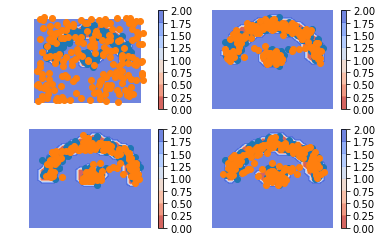

iteration  487
-0.045566976 0.0031677766 0.8047557 -0.8534904


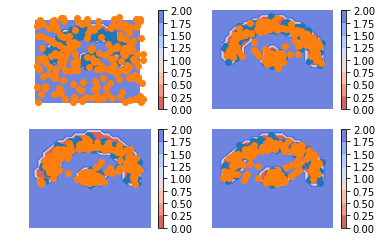

iteration  488
-0.04683298 0.0037359532 0.7907204 -0.84128934


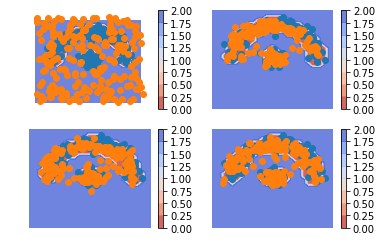

iteration  489
-0.064035475 0.004150327 0.8112519 -0.8794377


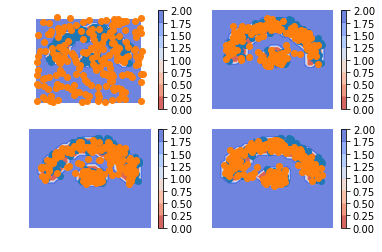

iteration  490
-0.03729403 0.0045752106 0.83981776 -0.881687


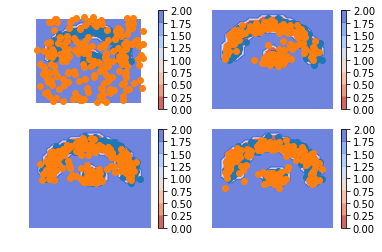

iteration  491
-0.049318254 0.00496799 0.8026338 -0.85692006


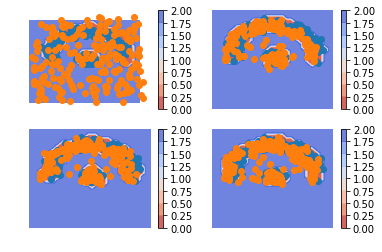

iteration  492
-0.06528187 0.0053090598 0.79704976 -0.8676407


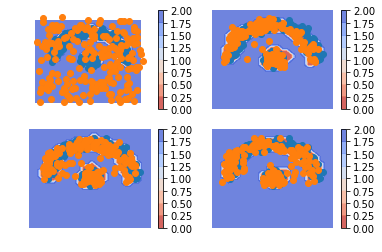

iteration  493
-0.034031093 0.0053310846 0.790157 -0.8295192


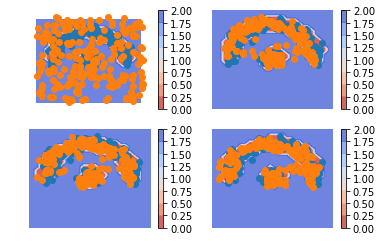

iteration  494
-0.055583 0.005463167 0.80429685 -0.86534303


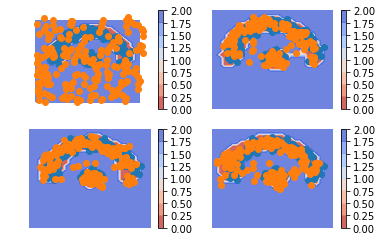

iteration  495
-0.0067644715 0.0053257877 0.8168551 -0.82894534


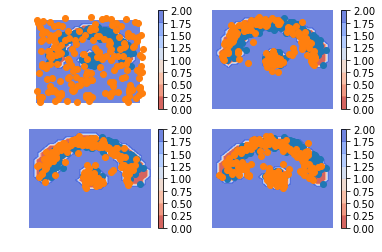

iteration  496
-0.011448681 0.004891409 0.8057242 -0.8220643


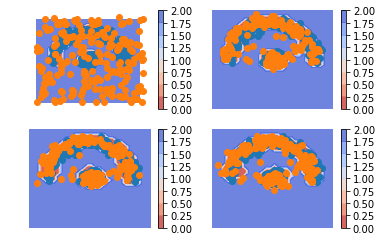

iteration  497
-0.025560379 0.0046392735 0.8150798 -0.84527946


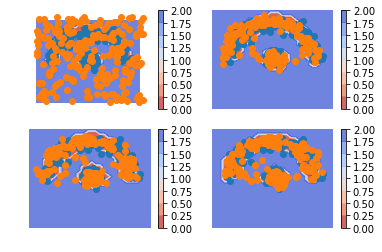

iteration  498
-0.009327352 0.0041621183 0.79158354 -0.805073


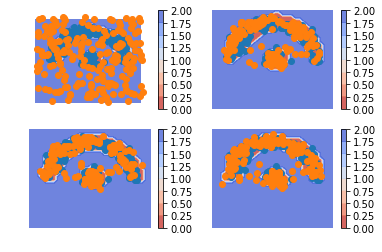

iteration  499
0.011866391 0.0039876495 0.799479 -0.7916003


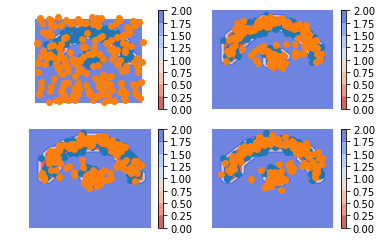

In [11]:
saver=tf.train.Saver()
with tf.Session() as sess:
    tf.global_variables_initializer().run()
    for i in range(500):
        print('iteration ',i)
        X_true=make_toy_dataset_old(200,0.1)
        X_fake=np.random.uniform(low=-1.5,high=1.5,size=(200,2))
        X_noise=np.random.uniform(low=-1.5,high=1.5,size=(200,2))
        image=np.vstack((X_true,X_fake,X_noise))
        label=np.concatenate((np.zeros(200),np.ones(200),2*np.ones(200)))
        loss_num,l1,l2,l3,i_his=sess.run([tot_loss,tot_latent_loss,tot_classifier_loss,tot_likelihood_loss,image_his],feed_dict={X:image,y:label})
        for t in range(10):
            _=sess.run([train_step1],feed_dict={X:image,y:label})
        _=sess.run([train_step2],feed_dict={X:image,y:label})
        print(loss_num,l1,l2,l3)
#         print(label)
#         print([(a.reshape(-1,)>0.5).astype(dtype=np.int32) for a in p_his])
        display(i_his,i)
        save_path = saver.save(sess, "parameters/toy/toy.ckpt")

In [12]:
'''
**************************************************************************************************************
There is a problem with classifier. 
Saparate classifier behave well, but in model it fails
**************************************************************************************************************
'''
# t=1
# plt.scatter(i_his[t][:200,0],i_his[t][:200,1])
# plt.scatter(i_his[t][200:,0],i_his[t][200:,1])
# plt.show()

# # n_out1=tf.layers.dense(X,units=100,activation=tf.nn.relu)
# # n_score=tf.layers.dense(n_out1,units=1)

# with tf.variable_scope("temp_scope") as vs:
#     classifier=Classifier()
#     n_score,prob,predict=classifier(X)

# with tf.Session() as sess:
#     tf.global_variables_initializer().run()
    
#     h=0.1
#     xx, yy = np.meshgrid(
#         np.arange(-1.5, 1.5, h),
#         np.arange(-1.5, 1.5, h))
#     points=np.c_[xx.ravel(), yy.ravel()]

#     Z=sess.run(n_score,feed_dict={X:points})
#     Z=Z.reshape(xx.shape)
#     _=plt.contourf(xx,yy,Z,cmap=plt.cm.coolwarm_r, alpha=0.8)
#     plt.scatter(i_his[t][:200,0],i_his[t][:200,1])
#     plt.scatter(i_his[t][200:,0],i_his[t][200:,1])
#     plt.axis('off')
#     plt.colorbar(_)
#     plt.show()
    

'\n**************************************************************************************************************\nThere is a problem with classifier. \nSaparate classifier behave well, but in model it fails\n**************************************************************************************************************\n'

In [13]:
a=tf.constant([[0],[1]])
b=tf.constant([[1],[2]])
d=[a,b]
c=tf.reduce_sum(d,axis=0)

with tf.Session() as sess:
    print(sess.run(d))
    print(sess.run(c))

[array([[0],
       [1]], dtype=int32), array([[1],
       [2]], dtype=int32)]
[[1]
 [3]]


INFO:tensorflow:Restoring parameters from parameters/toy/toy.ckpt


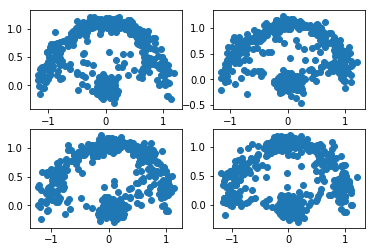

In [14]:
G_batch_size=tf.placeholder(shape=(),dtype=tf.int32,name='batch_size')
G_state_decode=vae.decoder_lstm.zero_state(G_batch_size, tf.float32)
G_unit_gaussian=tf.distributions.Normal(loc=tf.zeros((G_batch_size,vae.latent_dim)),scale=tf.ones((G_batch_size,vae.latent_dim)))

G_output_his=[]

for t in range(vae.n_time):
    G_Z=G_unit_gaussian.sample()
    with tf.variable_scope("LSTM_decoder") as vs:
        G_decode_out,G_state_decode=vae.decoder_lstm(G_Z,G_state_decode)
    G_output_image=vae.emit_net(G_decode_out)
    G_output_his.append(G_output_image)
    
with tf.Session() as sess:
    tf.global_variables_initializer().run()
    saver.restore(sess, "parameters/toy/toy.ckpt")
    output=sess.run(G_output_his,feed_dict={G_batch_size:500})
    plt.figure(1)
    for i in range(4):
        plt.subplot(2,2,i+1)
        plt.scatter(output[i][:,0],output[i][:,1])
    plt.savefig('figures/generate_result.png')
    plt.show()